<a href="https://www.kaggle.com/code/igorfiori/data-hackers-challenge-2025?scriptVersionId=262212634" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

# **Análise Profunda do State of Data Brazil 2024-2025**
#### _Uma Exploração sobre Carreira, Remuneração e Tecnologias no Ecossistema de Dados Brasileiro_

---

### Introdução

O mercado de dados no Brasil está em plena expansão, tornando-se cada vez mais competitivo e complexo. Para navegar neste cenário, é fundamental compreender quem são os profissionais que o compõem, quais tecnologias dominam e quais são os desafios e oportunidades presentes. O **"State of Data Brazil"**, a maior pesquisa sobre o mercado de dados no país realizada pelo **Data Hackers**, serve como uma fonte de informação indispensável para essa compreensão.

Este projeto se propõe a realizar uma **Análise Exploratória de Dados (EDA)** aprofundada sobre os resultados da edição de 2024-2025 da pesquisa. O objetivo é traduzir os dados brutos em *insights* visuais e estatísticos, revelando as principais tendências e características do ecossistema de dados brasileiro. Ao longo desta análise, exploraremos desde o perfil demográfico dos profissionais até as nuances de remuneração por cargo e senioridade, as ferramentas e linguagens mais utilizadas e os desafios enfrentados por líderes e equipes no dia a dia.

Através de um processo cuidadoso de tratamento e visualização de dados, utilizando as principais bibliotecas do ecossistema Python, como **Pandas, Matplotlib e Seaborn**, este notebook busca não apenas validar as conclusões gerais da pesquisa, mas também descobrir novos padrões e correlações que possam enriquecer o debate sobre o futuro do setor de dados no Brasil.

### pip install necessárias

In [1]:
!pip install geobr
!pip install unidecode

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 338.0/338.0 kB 10.1 MB/s eta 0:00:00
  Attempting uninstall: geopandas
    Found existing installation: geopandas 0.14.4
    Uninstalling geopandas-0.14.4:
      Successfully uninstalled geopandas-0.14.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
bigframes 1.42.0 requires rich<14,>=12.4.4, but you have rich 14.0.0 which is incompatible.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 235.8/235.8 kB 7.7 MB/s eta 0:00:00


## Importação das Bibliotecas Essenciais

In [2]:
#bibliotecas de importação do dataset do kaggle
import kagglehub
from kagglehub.datasets import KaggleDatasetAdapter

# bibliotecas utilitarias 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter
import seaborn as sns
from ydata_profiling import ProfileReport
import geobr
import plotly.express as px

# bibliotecas de warnings ignore & remoção de acentos
import warnings
import re
from unidecode import unidecode

warnings.filterwarnings('ignore')

print("Importação das bibliotecas executada com sucesso.")

Importação das bibliotecas executada com sucesso.


## Carregamento e diagnóstico inicial dos dados

In [3]:
df = pd.read_csv('/kaggle/input/state-of-data-brazil-20242025/Final Dataset - State of Data 2024 - Kaggle - df_survey_2024.csv', encoding='utf-8')

print("\nVisualização das 5 primeiras linhas:")
display(df.head())


Visualização das 5 primeiras linhas:


,0.a_token,0.d_data/hora_envio,1.a_idade,1.a.1_faixa_idade,1.b_genero,1.c_cor/raca/etnia,1.d_pcd,1.e_experiencia_profissional_prejudicada,1.e.1_Não acredito que minha experiência profissional seja afetada,"1.e.2_Sim, devido a minha Cor/Raça/Etnia",...,"8.d.3_Entrando em contato com os times de negócio para definição do problema, identificar a solução e apresentação de resultados.",8.d.4_Desenvolvendo modelos de Machine Learning com o objetivo de colocar em produção em sistemas (produtos de dados).,"8.d.5_Colocando modelos em produção, criando os pipelines de dados, APIs de consumo e monitoramento.","8.d.6_Cuidando da manutenção de modelos de Machine Learning já em produção, atuando no monitoramento, ajustes e refatoração quando necessário.","8.d.7_Realizando construções de dashboards em ferramentas de BI como PowerBI, Tableau, Looker, Qlik, etc.","8.d.8_Utilizando ferramentas avançadas de estatística como SAS, SPSS, Stata etc, para realizar análises.","8.d.9_Criando e dando manutenção em ETLs, DAGs e automações de pipelines de dados.",8.d.10_Criando e gerenciando soluções de Feature Store e cultura de MLOps.,"8.d.11_Criando e mantendo a infra que meus modelos e soluções rodam (clusters, servidores, API, containers, etc.)",8.d.12_Treinando e aplicando LLM's para solucionar problemas de negócio.
0,reb94rv0msth7q4nreb94riaq80iz3yi,16/10/2024 11:19:17,18,17-21,Masculino,Branca,Não,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1zc66g69jjt49y32l1zc66g8wqj79m4e,16/10/2024 20:45:31,18,17-21,Masculino,Branca,Não,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,uu99wmam4n5kc2uu99wmydf0rk7l58f7,17/10/2024 18:10:59,18,17-21,Masculino,Parda,Não,Não acredito que minha experiência profissiona...,1.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3ynsw7z0hl5hhpbfvaeqk73ynsw7z04l,22/10/2024 18:03:00,18,17-21,Masculino,Branca,Não,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,v6bji2ct5xckpl1uouv6bjiotkrf3b4f,23/10/2024 01:33:23,18,17-21,Masculino,Branca,Não,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## **Análise Explorátoria Automatizada com `ydata-profiling` (Pré-limpeza)**

Particularmente gosto de usar o `ydata-profiling` para ter uma visão mais ampla do projeto e detalhado.

In [4]:
profile = ProfileReport(
    df, 
    title="Relatório Dataset State Of Data Brazil - Pré Limpeza", 
    explorative=True,
    progress_bar=False 
)
 
profile.to_file("relatorio_dataset_state_of_data_brazil_2025_pre_limpeza.html")

100%|██████████| 403/403 [00:16<00:00, 24.93it/s]


## **Limpeza e preparação dos dados**

Antes de iniciar a análise exploratória, utilizamos a biblioteca `ydata-profiling` para gerar um relatório diagnóstico completo do nosso dataset. Essa análise inicial automatizada é crucial, pois nos fornece um panorama detalhado sobre a estrutura e a qualidade dos dados, funcionando como um mapa que guia nossas ações de limpeza.

Com base nos diagnósticos, o objetivo desta etapa é realizar a limpeza e a preparação do dataset. Este processo é fundamental para garantir a qualidade e a confiabilidade das nossas futuras análises, tratando as inconsistências e estruturando os dados para formar uma base sólida para o projeto.


### Tratamento de registros duplicados

Uma verificação inicial comum em qualquer conjunto de dados é a busca por registros duplicados. Linhas idênticas podem distorcer os resultados de uma análise ao super-representar um mesmo respondente. Para garantir a integridade do nosso estudo, vamos identificar e remover essas duplicatas.

In [5]:
# Mostra o tamanho original do dataset
print(f"Tamanho original do dataset: {df.shape}")

# Remove as linhas duplicadas
df_sem_duplicadas = df.drop_duplicates()

# Mostra o novo tamanho e a quantidade de linhas removidas
print(f"Tamanho do dataset após remover duplicadas: {df_sem_duplicadas.shape}")
print(f"Foram removidas {df.shape[0] - df_sem_duplicadas.shape[0]} linhas duplicadas.")

df = df_sem_duplicadas

Tamanho original do dataset: (5217, 403)
Tamanho do dataset após remover duplicadas: (5215, 403)
Foram removidas 2 linhas duplicadas.


### Remoção de Colunas Irrelevantes e Constantes

Um passo importante na limpeza é remover colunas que não contribuem com informação útil. Nesta etapa, faremos dois tipos de remoção:
* **Colunas Irrelevantes:** `'0.a_token'` e `'0.d_data/hora_envio'`, que são metadados da pesquisa sem valor analítico para nossos objetivos.
* **Colunas Constantes:** Colunas que não apresentam variação nos dados, como a `'4.d.15_Não utilizo nenhuma das linguagens listadas'`, identificada no relatório de profiling.

A remoção destas colunas simplifica nosso dataset, permitindo focar nas variáveis que realmente importam.

In [6]:
# Lista de colunas a serem removidas 
colunas_para_remover = ['4.d.15_Não utilizo nenhuma das linguagens listadas','0.a_token','0.d_data/hora_envio']

# Mostra o número de colunas antes da remoção
print(f"Número de colunas antes da remoção: {df.shape[1]}")

# Remove as colunas do DataFrame
df = df.drop(columns=colunas_para_remover)

# Mostra o número de colunas após a remoção
print(f"Número de colunas após a remoção: {df.shape[1]}")
print(f"Foram removidas {len(colunas_para_remover)} colunas.") 

Número de colunas antes da remoção: 403
Número de colunas após a remoção: 400
Foram removidas 3 colunas.


### Estratégia para valores ausentes (Missing Values)

O diagnóstico inicial revelou um dado que merece atenção: aproximadamente 57% do nosso dataset é composto por valores ausentes (`NaN`). Em muitos contextos, um percentual tão alto poderia indicar problemas na coleta ou corrupção dos dados. No entanto, aqui, este é um comportamento esperado e que reflete a inteligência na construção do questionário.

A pesquisa foi desenhada com uma lógica de ramificação, onde os participantes só respondem a perguntas relevantes para seu perfil e atuação profissional. Por exemplo, um Analista de Dados não era exposto às perguntas específicas de Engenharia de Dados. Portanto, um valor nulo (`NaN`) não significa uma "resposta que faltou", mas sim uma "pergunta não aplicável" para aquele respondente.

Com isso em mente, seria um erro metodológico tentar preencher esses valores com técnicas de imputação (como média, mediana ou moda), pois estaríamos criando informações artificiais e distorcendo a realidade dos dados.

**Nossa estratégia será, portanto, a análise por segmentação.** Não modificaremos o dataset principal. Em vez disso, durante a fase de análise exploratória, criaremos subconjuntos de dados temporários para cada perfil que desejarmos investigar (ex: um dataframe apenas com gestores para analisar os desafios de gestão). Esta abordagem respeita a estrutura dos dados e nos permitirá realizar análises profundas e precisas dentro de cada segmento relevante. Nenhuma ação de remoção ou alteração de linhas será executada nesta etapa.

### Análise de alta correlação

Finalmente, o relatório diagnóstico apontou um número elevado de colunas com alta correlação. Assim como os valores ausentes, este não é um erro, mas uma consequência da forma como a pesquisa foi estruturada. Muitas perguntas são desdobramentos de respostas anteriores, gerando uma correlação natural. Por exemplo, a resposta à pergunta "Você mora no Brasil?" estará altamente correlacionada com a resposta à pergunta "Em qual estado você mora?".

**Nossa estratégia para lidar com a correlação será dividida em duas frentes:**

1.  **Durante a Análise Exploratória (EDA):** Manteremos todas as colunas. A chave aqui será a **consciência**. Sabendo que certas colunas são correlacionadas, evitaremos criar gráficos redundantes ou tirar conclusões duplas da mesma informação subjacente. Não removeremos colunas nesta fase, pois elas podem ter valor individual para a interpretação e o *storytelling*.

2.  **Durante a Modelagem (se aplicável):** Caso decidamos construir um modelo de Machine Learning, a alta correlação (multicolinearidade) precisa ser tratada. Nessa situação, aplicaríamos técnicas de seleção de features, escolhendo apenas uma coluna de um par altamente correlacionado ou utilizando métodos de redução de dimensionalidade como o PCA. Para o escopo deste desafio, o foco principal será na análise exploratória.

Com isso, concluímos a documentação de toda a nossa estratégia de limpeza e preparação.

# **Engenharia de Features**

Com o dataset limpo, nosso próximo passo é a **Engenharia de Features**. O objetivo é criar ou transformar colunas para facilitar e potencializar nossa análise.

### Definição da Coluna de Cargo Principal

Nossa primeira e mais importante tarefa de engenharia de features é consolidar a função de cada respondente em uma única coluna de fácil acesso. Após a investigação dos dados, descobrimos que a coluna `'4.a_funcao_de_atuacao'` já contém essa informação de forma clara.

Para tornar nosso código mais limpo e intuitivo nas próximas etapas, vamos criar a coluna `'cargo_principal'` como uma cópia direta desta, que servirá como a base para segmentar nossas análises.

In [7]:
# Criação da coluna de cargo principal
# A coluna '4.a_funcao_de_atuacao' contém a função de cada respondente.
# Criamos a coluna 'cargo_principal' como uma cópia para facilitar o manuseio.
df['cargo_principal'] = df['4.a_funcao_de_atuacao']
print("Coluna 'cargo_principal' criada com sucesso.")


# Verificação formatada da distribuição de cargos
contagem_df = df['cargo_principal'].value_counts(dropna=False).to_frame()

Coluna 'cargo_principal' criada com sucesso.


### Verificação Formatada da Distribuição

Agora, vamos verificar o resultado da nossa criação. Em vez de uma lista simples, vamos apresentar a distribuição dos cargos como uma tabela limpa e bem formatada, pronta para qualquer relatório.

In [8]:
# Contamos os valores e transformamos a saída em um DataFrame para uma melhor visualização.
contagem_df = df['cargo_principal'].value_counts(dropna=False).to_frame()

# Convertemos o índice (os nomes dos cargos) em uma coluna e renomeamos para clareza.
contagem_df = contagem_df.reset_index()
contagem_df.columns = ['Função de Atuação', 'Quantidade']

print("Distribuição dos cargos na nova coluna 'cargo_principal':")
contagem_df

Distribuição dos cargos na nova coluna 'cargo_principal':


,Função de Atuação,Quantidade
0,*Análise de Dados/BI:* Extrai e cruza dados un...,1668
1,NaN,1418
2,*Engenharia de Dados:* Modela soluções de arqu...,928
3,*Ciência de Dados/Machine Learning/AI: *Desenh...,773
4,"Atuo na área de dados, mas não atuo em nenhuma...",229
5,Não atuo na área de dados.,199


### Padronização dos Rótulos de Cargo

Agora que temos nossa coluna `cargo_principal`, notamos que os nomes dos cargos são muito longos para serem usados em gráficos. Para facilitar a leitura e a visualização, vamos padronizar esses nomes para versões mais curtas e diretas.

In [9]:
# Criamos um dicionário que traduz o nome longo para o nome curto.
mapa_cargos = {
    '*Análise de Dados/BI:* Extrai e cruza dados unindo diferentes fontes da informação; analisa dados visando identificar padrões, gerar insights e levantar perguntas; desenvolve dashboards, relatórios e visualizações de dados em ferramentas de BI.': 'Análise de Dados / BI',
    '*Engenharia de Dados:* Modela soluções de arquitetura de dados; define modelagens de repositórios de dados (Data Lake, Data Warehouse, Data Lakehouse); desenvolve estratégias de aquisição de dados, recuperação de informação e pipelines de dados.': 'Engenharia de Dados',
    '*Ciência de Dados/Machine Learning/AI: *Desenha e executa experimentos com o objetivo de responder perguntas do negócio; desenvolve modelos preditivos e algoritmos de Machine Learning com o objetivo de otimizar e automatizar a tomada de decisão.': 'Ciência de Dados / ML',
    'Atuo na área de dados, mas não atuo em nenhuma das frentes citadas.': 'Outras Funções de Dados',
    'Não atuo na área de dados.': 'Não atua na área de dados'
}

# Aplicamos esse mapa à coluna 'cargo_principal'.
# O pandas irá substituir cada nome longo pelo seu correspondente nome curto.
df['cargo_principal'] = df['cargo_principal'].map(mapa_cargos)

print("Rótulos da coluna 'cargo_principal' padronizados com sucesso!")
df['cargo_principal'].value_counts(dropna=False)

Rótulos da coluna 'cargo_principal' padronizados com sucesso!


cargo_principal
Análise de Dados / BI        1668
NaN                          1418
Engenharia de Dados           928
Ciência de Dados / ML         773
Outras Funções de Dados       229
Não atua na área de dados     199
Name: count, dtype: int64

### Criação da Coluna de Nível de Carreira Unificada

Para facilitar a análise de senioridade, notamos que os gestores são identificados em uma coluna separada (`'2.e_cargo_como_gestor'`) dos contribuidores individuais (`'2.g_nivel'`). Nesta etapa, vamos criar uma nova coluna, `'nivel_carreira'`, que unifica todas essas categorias em um único lugar, permitindo uma visualização completa da pirâmide de experiência.

In [10]:
# Primeiro, definimos nossas regras de negócio: uma lista de condições e os resultados esperados.
conditions = [
    (df['2.e_cargo_como_gestor'] == 'Team Leader/Tech Leader'),
    (df['2.e_cargo_como_gestor'] == 'Supervisor/Coordenador'),
    (df['2.e_cargo_como_gestor'] == 'Gerente/Head'),
    (df['2.e_cargo_como_gestor'] == 'Diretor/VP'),
    (df['2.e_cargo_como_gestor'] == 'Sócio ou C-level (CEO, CDO, CIO, CTO etc)')
]

# Esta é a lista de novos valores que queremos atribuir, na mesma ordem das condições.
choices = ['Líder Técnico','Coordenador/Supervisor','Gerente/Head','Diretor/VP','Sócio / C-level']

df['nivel_carreira'] = np.select(conditions, choices, default=df['2.g_nivel'])

print("Coluna 'nivel_carreira' unificada criada com sucesso!")
# Verificamos a distribuição da nossa nova coluna para confirmar que todos os grupos estão presentes.
df['nivel_carreira'].value_counts(dropna=False)

Coluna 'nivel_carreira' unificada criada com sucesso!


nivel_carreira
Sênior                    1572
Pleno                     1376
Júnior                     868
Gerente/Head               400
Coordenador/Supervisor     366
NaN                        354
Líder Técnico              148
Sócio / C-level             79
Diretor/VP                  52
Name: count, dtype: int64

### Conversão da faixa salarial para valor numérico

A coluna `'2.h_faixa_salarial'` contém informações cruciais em formato de texto. Para podermos realizar análises quantitativas, como calcular médias, precisamos converter essas faixas em um valor numérico. Nossa estratégia será criar a coluna `'salario_estimado_numerico'`, que representará o ponto médio de cada faixa.

In [11]:
def converter_faixa_salarial(faixa):
    """
    Converte uma string de faixa salarial (ex: "de R$ 4.001 a R$ 6.000")
    para um valor numérico representando o ponto médio da faixa.
    """
    # Se o valor for nulo (NaN), retorna nulo.
    if pd.isnull(faixa):
        return np.nan

    # Limpa a string e extrai os números usando expressões regulares.
    numeros_str = re.findall(r'\d+\.?\d*', faixa.replace('.', ''))
    numeros = [float(n) for n in numeros_str]

    # Aplica a lógica para calcular o valor representativo.
    if len(numeros) == 2:
        return np.mean(numeros)  # Ponto médio
    elif len(numeros) == 1:
        return numeros[0]  # Casos "Mais de" ou "Menos de"
    else:
        return np.nan 

In [12]:
# Aplica a função para criar a nova coluna.
df['salario_estimado_numerico'] = df['2.h_faixa_salarial'].apply(converter_faixa_salarial)

print("Coluna 'salario_estimado_numerico' criada com sucesso!")

Coluna 'salario_estimado_numerico' criada com sucesso!


In [13]:
# Mostra a coluna original e a nova coluna lado a lado para comparação.
print("Amostra da conversão:")
print(df[['2.h_faixa_salarial', 'salario_estimado_numerico']].dropna().head())

print("\nEstatísticas descritivas da nova coluna:")
df['salario_estimado_numerico'].describe()

Amostra da conversão:
               2.h_faixa_salarial  salario_estimado_numerico
0  de R$ 1.001/mês a R$ 2.000/mês                     1500.5
1           Menos de R$ 1.000/mês                     1000.0
2  de R$ 1.001/mês a R$ 2.000/mês                     1500.5
3  de R$ 1.001/mês a R$ 2.000/mês                     1500.5
4  de R$ 1.001/mês a R$ 2.000/mês                     1500.5

Estatísticas descritivas da nova coluna:


count     4861.000000
mean     11921.819790
std       8617.022256
min       1000.000000
25%       5000.500000
50%      10000.500000
75%      14000.500000
max      40001.000000
Name: salario_estimado_numerico, dtype: float64

### Conversão do tempo de experiência para valor numérico

De forma semelhante, a coluna `'2.i_tempo_de_experiencia_em_dados'` também está em formato de texto. Criaremos a feature `'experiencia_em_dados_anos'` usando a mesma lógica de extrair o ponto médio das faixas para obter uma variável numérica.

In [14]:
# Vamos listar todas as categorias de tempo de experiência presentes no dataset.
print("Faixas de experiência existentes no dataset:")
df['2.i_tempo_de_experiencia_em_dados'].unique()

Faixas de experiência existentes no dataset:


array(['de 1 a 2 anos', 'Menos de 1 ano',
       'Não tenho experiência na área de dados', nan, 'de 5 a 6 anos',
       'de 3 a 4 anos', 'de 7 a 10 anos', 'Mais de 10 anos'], dtype=object)

In [15]:
# Por clareza, vamos criar uma função com um nome específico para esta tarefa.
def converter_faixa_experiencia(faixa):
    """
    Converte uma string de faixa de experiência (ex: "de 1 a 2 anos")
    para um valor numérico representando o ponto médio da faixa em anos.
    """
    if pd.isnull(faixa):
        return np.nan

    # A expressão regular é a mesma, pois busca por números.
    numeros_str = re.findall(r'\d+', faixa)
    numeros = [float(n) for n in numeros_str]

    if len(numeros) == 2:
        return np.mean(numeros)
    elif len(numeros) == 1:
        if 'Menos de 1 ano' in faixa:
            return 0.5 # Representando meio ano
        elif 'Mais de 10 anos' in faixa:
            return numeros[0]
    return np.nan

In [16]:
# Aplica a função para criar a nova coluna.
df['experiencia_em_dados_anos'] = df['2.i_tempo_de_experiencia_em_dados'].apply(converter_faixa_experiencia)
print("Coluna 'experiencia_em_dados_anos' criada com sucesso!")

# Verifica o resultado
print("\n--- Amostra da conversão ---")
print(df[['2.i_tempo_de_experiencia_em_dados', 'experiencia_em_dados_anos']].dropna().head())

print("\n--- Estatísticas descritivas da nova coluna ---")
print(df['experiencia_em_dados_anos'].describe())

Coluna 'experiencia_em_dados_anos' criada com sucesso!

--- Amostra da conversão ---
  2.i_tempo_de_experiencia_em_dados  experiencia_em_dados_anos
0                     de 1 a 2 anos                        1.5
1                    Menos de 1 ano                        0.5
3                    Menos de 1 ano                        0.5
4                    Menos de 1 ano                        0.5
6                     de 5 a 6 anos                        5.5

--- Estatísticas descritivas da nova coluna ---
count    4631.000000
mean        4.631397
std         3.030418
min         0.500000
25%         1.500000
50%         3.500000
75%         5.500000
max        10.000000
Name: experiencia_em_dados_anos, dtype: float64


### Preparação dos Dados Geográficos para o Mapa

Como um passo final da nossa engenharia de features, vamos preparar um dataset específico para a visualização geográfica. O objetivo é criar um GeoDataFrame que combine a contagem de profissionais por estado com as respectivas formas geométricas do mapa do Brasil. Este novo dataframe (`mapa_dados`) será o insumo direto para a criação do nosso mapa coroplético na etapa de análise.

In [17]:
# Carregamos as formas de todos os estados do Brasil
geo_brasil = geobr.read_state(year=2020)

# Preparamos nossa contagem de respondentes por UF
contagem_por_uf = df['1.i.1_uf_onde_mora'].value_counts().reset_index()
contagem_por_uf.columns = ['uf', 'quantidade']

# Padronizamos os nomes das colunas para a união
geo_brasil = geo_brasil.rename(columns={'abbrev_state': 'uf'})

# Unimos os dois dataframes para criar nosso dataset final para o mapa
mapa_dados = geo_brasil.merge(contagem_por_uf,on='uf',how='left')

# Preenchemos com 0 os estados que não tiveram respondentes.
mapa_dados['quantidade'] = mapa_dados['quantidade'].fillna(0)

print("GeoDataFrame para o mapa criado com sucesso!")
mapa_dados[['uf', 'name_state', 'quantidade']].head()

GeoDataFrame para o mapa criado com sucesso!


,uf,name_state,quantidade
0,RO,Rondônia,13.0
1,AC,Acre,0.0
2,AM,Amazônas,23.0
3,RR,Roraima,0.0
4,PA,Pará,18.0


## **Relatório Pós-Limpeza e Engenharia de Features**

Para consolidar e documentar todas as nossas etapas de limpeza e engenharia de features, vamos gerar um novo relatório de profiling. Este relatório servirá como uma fotografia do nosso dataset "depois" do tratamento, nos permitindo comparar com o estado inicial e verificar o impacto das nossas transformações, especialmente a criação das novas colunas numéricas.

In [18]:
# Gerando o novo relatório de profiling
profile_pos_limpeza = ProfileReport(
    df,
    title="Relatório Dataset State Of Data Brazil - Pós Limpeza e Engenharia de Features",
    explorative=True,
    progress_bar=False
)

profile_pos_limpeza.to_file("relatorio_dataset_state_of_data_brazil_2025_pos_limpeza.html")

100%|██████████| 404/404 [00:21<00:00, 18.75it/s]


### **Configurações e Constantes do Projeto**

Vamos centralizar todas as nossas padronizações para garantir consistência e facilitar a manutenção ao longo do notebook. Isso inclui os padrões visuais para os gráficos e a ordem lógica para as nossas variáveis categóricas ordinais.

### Padrões de estilos e cores

Para garantir uma identidade visual coesa e profissional para todo o nosso projeto, vamos centralizar nesta célula todas as nossas padronizações de estilo e cores.

Essa abordagem não só garante que todos os gráficos tenham a mesma aparência (facilitando a leitura e a comparação), como também torna nosso código de plotagem muito mais limpo e eficiente, pois não precisaremos definir esses parâmetros repetidamente.

Aqui, vamos estabelecer nosso tema "Azul Profissional", que consiste em um fundo branco, linhas de grade sutis para referência, e uma paleta de cores principal baseada em tons de azul, além de padronizar os tamanhos e cores das fontes.

In [19]:
# Usamos o 'whitegrid' como base para ter as linhas de grade.
plt.style.use('seaborn-v0_8-whitegrid')

# Ajustamos os parâmetros globais para o tema claro.
plt.rcParams['figure.figsize'] = (12, 8)
plt.rcParams['font.size'] = 12
plt.rcParams['text.color'] = 'black'
plt.rcParams['axes.labelcolor'] = 'black'
plt.rcParams['xtick.color'] = 'black'
plt.rcParams['ytick.color'] = 'black'

# Ajuste das "linhas claras com opacidade" (grid)
plt.rcParams['grid.color'] = 'grey'
plt.rcParams['grid.linestyle'] = '--'
plt.rcParams['grid.alpha'] = 0.2  # Deixa as linhas de grade bem sutis

# Definição da nossa nova paleta de azuis.
# Usaremos a versão reversa para que os valores maiores tenham o azul mais escuro e forte.
PALETA_PRINCIPAL = 'Blues'
PALETA_PRINCIPAL_REVERSA = 'Blues_r' # A versão normal se torna a reversa neste contexto
COR_PRINCIPAL = '#08519c'

# Aplicamos a paleta padrão para o Seaborn
sns.set_palette(PALETA_PRINCIPAL)
print("Novo padrão visual (Azul Profissional) definido com sucesso!")

Novo padrão visual (Azul Profissional) definido com sucesso!


### Paleta de cor por ranking

Para nossos gráficos com variáveis ordinais (como idade ou escolaridade), queremos uma visualização especial: as barras devem estar em ordem lógica (ex: do mais novo ao mais velho), mas as cores devem destacar as categorias com mais respondentes.

Fazer isso manualmente para cada gráfico seria repetitivo. Por isso, vamos criar uma função "helper" chamada `criar_paleta_por_ranking`. Ela funcionará como uma "fábrica" que recebe nossos dados e nos devolve a paleta de cores customizada e pronta para ser usada, encapsulando toda a lógica complexa de contagem, ranking e mapeamento de cores.

In [20]:
def criar_paleta_por_ranking(dataframe, coluna, ordem):
    """
    Cria uma paleta de cores para um gráfico de barras ordenado.
    A ordem das barras é definida pela lista 'ordem', mas a cor de cada
    barra é definida pela sua quantidade (ranking).
    """
    # Contagem e Ranking
    contagem = dataframe[coluna].value_counts()
    ranking = contagem.rank(ascending=False, method='first').astype(int)

    # Criação da paleta e do mapa de cores
    paleta_sns = sns.color_palette(PALETA_PRINCIPAL_REVERSA, n_colors=len(contagem))
    mapa_cores = {categoria: paleta_sns[ranking[categoria] - 1] for categoria in contagem.index}

    # Geração da lista de cores na ordem final
    cores_finais = [mapa_cores.get(categoria, '#cccccc') for categoria in ordem]
    
    return cores_finais

print("Função 'criar_paleta_por_ranking' definida.")

Função 'criar_paleta_por_ranking' definida.


### Ordem da Variável de Idade

A faixa etária é uma variável **ordinal**, ou seja, suas categorias possuem uma ordem natural e lógica (do mais novo ao mais velho). Se deixarmos as ferramentas de visualização ordenarem por padrão (geralmente por ordem alfabética ou por quantidade), o resultado pode ficar confuso e quebrar a narrativa cronológica.

Para garantir que nossos gráficos sempre apresentem as idades na sequência correta, vamos definir uma lista padrão, `ORDEM_IDADE`, que será usada como um "gabarito" para a ordenação em todas as nossas análises.

In [21]:
ORDEM_IDADE = ['17-21', '22-24', '25-29', '30-34', '35-39', '40-44','45-49', '50-54', '55-59', '60+']

print("Lista de ordem idade pronta para a EDA.")

Lista de ordem idade pronta para a EDA.


### Ordem da Variável de Escolaridade

Assim como a idade, o nível de escolaridade também é uma variável **ordinal**. Suas categorias seguem uma jornada educacional lógica, do nível mais básico ao mais avançado.

Para garantir que nossos gráficos sempre respeitem essa progressão natural, definimos a lista `ORDEM_ESCOLARIDADE`. Ela servirá como um "molde" para ordenar corretamente as barras em qualquer visualização que envolva o nível de instrução, tornando a análise mais clara e intuitiva.

In [22]:
ORDEM_ESCOLARIDADE = ['Não tenho graduação formal','Estudante de Graduação','Graduação/Bacharelado','Pós-graduação','Mestrado','Doutorado ou Phd']

print("Lista de ordem escolaridade pronta para a EDA.")

Lista de ordem escolaridade pronta para a EDA.


### Ordem da Variável de Senioridade

A senioridade é, talvez, a variável ordinal mais importante em uma análise de carreira. Ela representa uma clara progressão de responsabilidades e experiência. Para garantir que nossas visualizações sempre sigam essa escada de crescimento de forma lógica, desde o nível Júnior até os cargos de C-level, definimos a constante `ORDEM_SENIORIDADE`.

Ela será nosso guia para todas as análises que envolvam o nível de carreira dos profissionais, garantindo que a história contada seja coerente com a realidade de uma trajetória profissional.

In [23]:
# Podemos adicionar a ordem de senioridade aqui também, para uso futuro.
ORDEM_SENIORIDADE = ['Júnior','Pleno','Sênior','Líder Técnico','Coordenador/Supervisor','Gerente/Head','Diretor/VP','Sócio / C-level']

print("Lista de ordem seneriodade pronta para a EDA.")

Lista de ordem seneriodade pronta para a EDA.


### Dicionários para quebra de linha em rótulos

Para garantir que nossos gráficos sejam sempre limpos e legíveis, mesmo quando as categorias têm nomes longos, vamos criar "dicionários de tradução".

A função desses dicionários é substituir um nome longo (ex: "Coordenador/Supervisor") por uma versão com quebra de linha (ex: "Coordenador/\nSupervisor"). Ao definirmos esses mapas como constantes, podemos reutilizá-los em múltiplos gráficos, garantindo uma formatação consistente e evitando a sobreposição de texto nos eixos.

In [24]:
# Dicionário para quebrar linhas em rótulos de gráficos longos.
MAPA_QUEBRA_LINHA = {
    'Líder Técnico': 'Líder\nTécnico',
    'Coordenador/Supervisor': 'Coordenador/\nSupervisor',
    'Gerente/Head': 'Gerente/\nHead',
    'Diretor/VP': 'Diretor/\nVP',
    'Sócio / C-level': 'Sócio /\nC-level'
}

print("Dicionário para rótulos de carreira definido.")

Dicionário para rótulos de carreira definido.


In [25]:
# Dicionário para quebrar linhas nos rótulos de escolaridade.
MAPA_QUEBRA_LINHA_ESCOLARIDADE = {
    'Não tenho graduação formal': 'Sem Graduação\nFormal',
    'Estudante de Graduação': 'Estudante de\nGraduação',
    'Graduação/Bacharelado': 'Graduação/\nBacharelado'
    # Os outros ("Pós-graduação", "Mestrado", etc.) são curtos o suficiente.
}

print("Dicionário para rótulos de escolaridade definido.")

Dicionário para rótulos de escolaridade definido.


# **Análise exploratória de dados (EDA)**

Com nosso dataset limpo e enriquecido com novas features, iniciamos agora a Análise Exploratória. O objetivo desta fase é investigar os dados, identificar padrões, testar hipóteses e extrair os primeiros insights através de estatísticas e visualizações.

## **Perfil Demográfico**

Para entender o cenário de dados no Brasil, o primeiro passo é responder à pergunta: "Quem é o profissional de dados brasileiro?". Nesta primeira seção da nossa análise, vamos construir esse perfil fundamental, pintando um retrato demográfico claro dos respondentes.

Começaremos nossa investigação pelo "onde", analisando a **distribuição geográfica** para identificar os principais polos de talentos no país, primeiro por **região** e depois detalhando por **estado**, culminando em um mapa de calor do Brasil. Em seguida, avançaremos para o "quem", investigando a composição da força de trabalho por **gênero** e por **faixa etária**, para compreendermos as gerações que moldam o mercado.

Ao final desta seção, teremos uma base sólida sobre o perfil dos profissionais que nos permitirá explorar, nas próximas etapas, como essas características se conectam com suas carreiras, salários e tecnologias.

### Distribuição por Região

Começamos com uma visão macro, analisando a concentração de profissionais nas cinco grandes regiões do Brasil para entender o cenário geral.

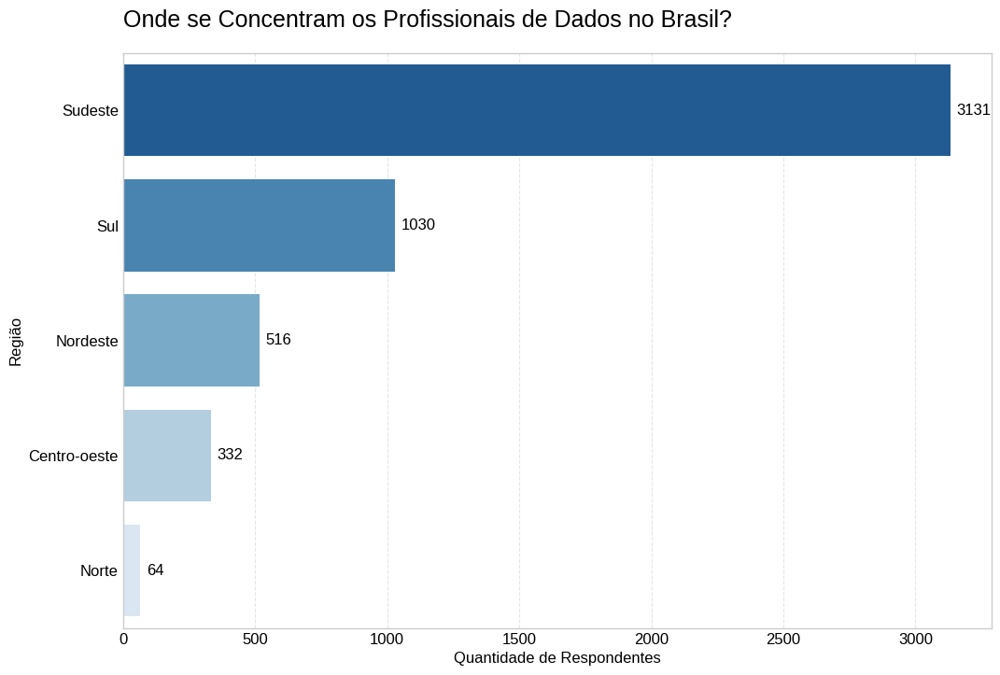

In [26]:
ax = sns.countplot(
    data=df,
    y='1.i.2_regiao_onde_mora',
    order=df['1.i.2_regiao_onde_mora'].value_counts().index,
    palette=PALETA_PRINCIPAL_REVERSA 
)

# Adiciona títulos e rótulos 
ax.set_title('Onde se Concentram os Profissionais de Dados no Brasil?', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Quantidade de Respondentes', fontsize=12)
ax.set_ylabel('Região', fontsize=12)

# Adiciona os valores nas barras para maior clareza
ax.bar_label(ax.containers[0], size=12, padding=5)

plt.show()

### Distribuição por estado

Agora, vamos detalhar a análise de localização para o nível estadual. Um ranking dos estados nos mostrará com mais precisão onde estão os maiores centros de profissionais de dados do país, além da clara concentração na região Sudeste.

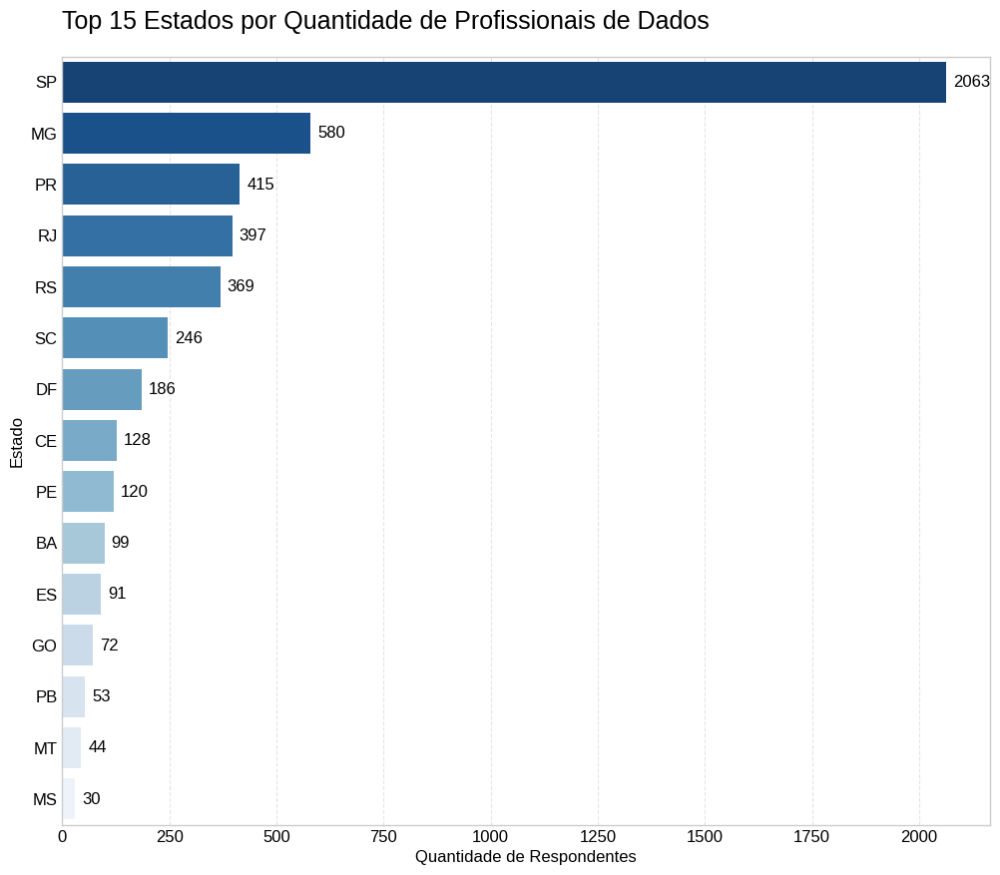

In [27]:
# Vamos focar nos 15 estados com maior número de respondentes para manter o gráfico legível.
top_15_estados = df['1.i.1_uf_onde_mora'].value_counts().nlargest(15)

# Gráfico de Barras para o Top 15 Estados
plt.figure(figsize=(12, 10))
ax = sns.barplot(
    y=top_15_estados.index, 
    x=top_15_estados.values, 
    palette=PALETA_PRINCIPAL_REVERSA
)

# Títulos e Rótulos
ax.set_title('Top 15 Estados por Quantidade de Profissionais de Dados', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Quantidade de Respondentes', fontsize=12)
ax.set_ylabel('Estado', fontsize=12)

# Adicionando os valores nas barras
ax.bar_label(ax.containers[0], size=12, padding=5)

plt.show()

### Análise Geográfica: Um Mapa de Calor dos Profissionais de Dados no Brasil

Para obtermos uma perspectiva geográfica e um impacto visual maior, vamos transformar nossa contagem de profissionais por estado em um **mapa coroplético**.

Para fazer isso da forma mais robusta, usaremos a biblioteca `geobr`, que nos dá acesso direto aos dados geográficos oficiais do Brasil.

In [28]:
# Criando o mapa coroplético padronizado
fig = px.choropleth(
    mapa_dados,
    geojson=mapa_dados.geometry,
    locations=mapa_dados.index,
    color='quantidade',
    color_continuous_scale=PALETA_PRINCIPAL, # <<< Usando nossa constante
    hover_name='name_state',
    hover_data={'quantidade': True}
)

# Ajustes de layout
# Ajustamos a visualização do mapa
fig.update_geos(fitbounds="locations", visible=False)

# Centralizamos todas as customizações de layout
fig.update_layout(
    title_text='Concentração de Profissionais de Dados por Estado no Brasil', 
    title_font_size=22, 
    title_x=0.5, 
    margin={"r":0,"t":50,"l":0,"b":0},
    coloraxis_colorbar=dict(title="Quantidade")
)

fig.show()

## **Análise por Gênero**

Após entendermos a distribuição geográfica, vamos analisar a composição de gênero dos profissionais. Esta visualização é fundamental, especialmente à luz dos insights do relatório oficial, que apontam a diversidade de gênero como um ponto crítico no setor.

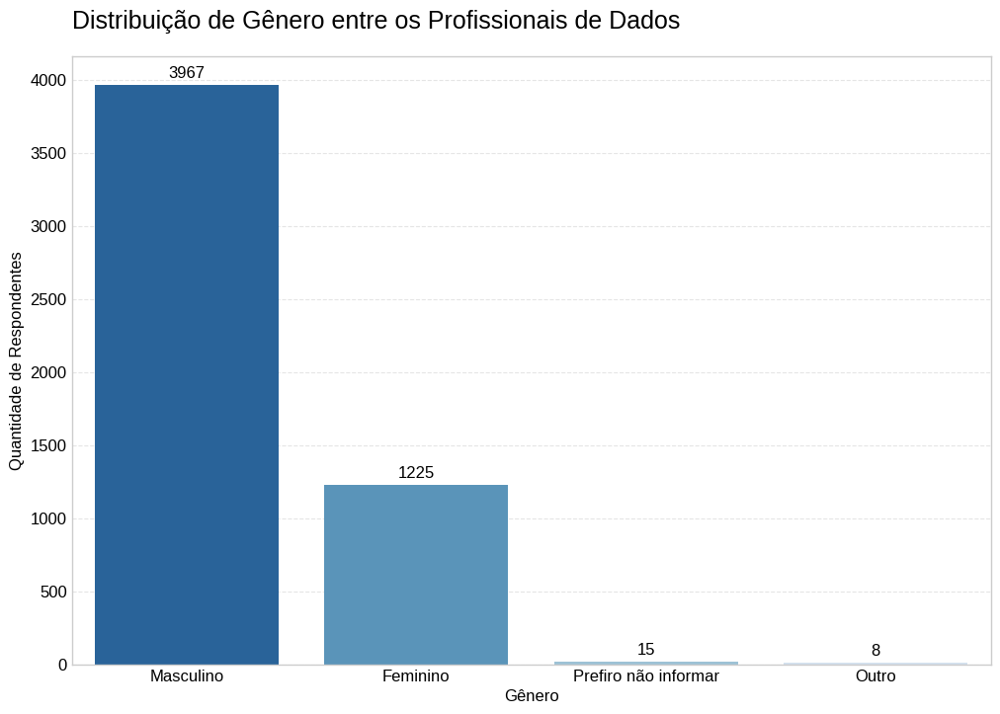

In [29]:
# Criando o gráfico de contagem para a coluna de gênero
ax = sns.countplot(
    data=df,
    x='1.b_genero',
    order=df['1.b_genero'].value_counts().index,
    palette=PALETA_PRINCIPAL_REVERSA 
)

# Adicionando títulos e rótulos
ax.set_title('Distribuição de Gênero entre os Profissionais de Dados', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Gênero', fontsize=12)
ax.set_ylabel('Quantidade de Respondentes', fontsize=12)

# Adicionando os valores no topo das barras
ax.bar_label(ax.containers[0], size=12, padding=3)

plt.show()

## **Análise por Faixa Etária**

Para visualizar melhor a progressão das idades, vamos reordenar o gráfico para seguir a ordem natural das faixas, da mais nova para a mais velha. Isso nos dará uma visão mais clara de como a quantidade de profissionais evolui ao longo das diferentes fases da carreira.

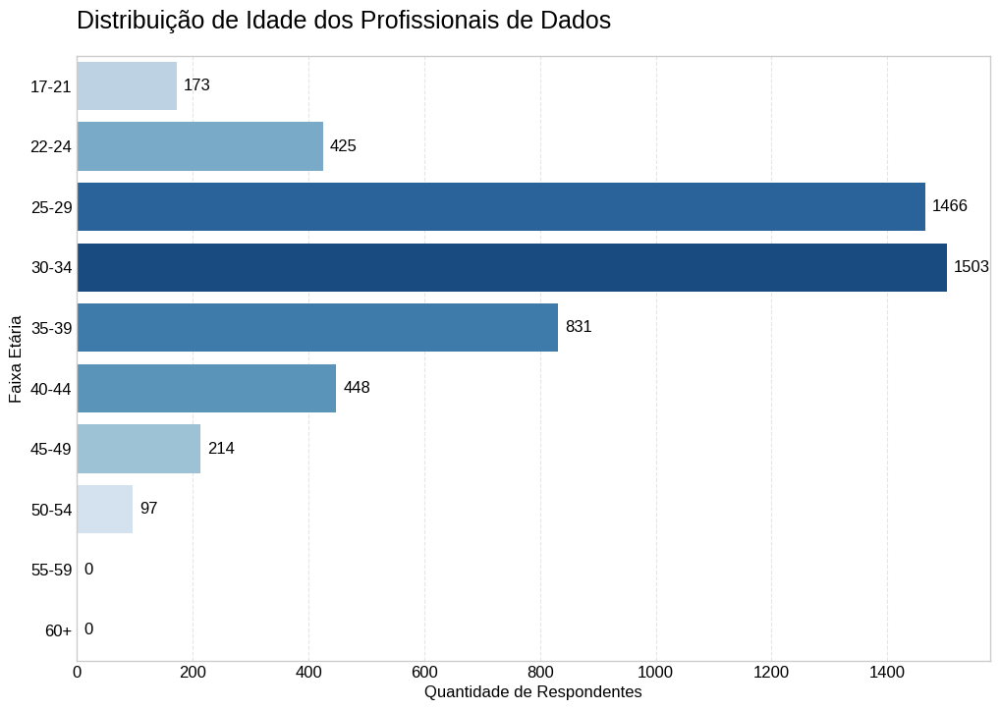

In [30]:
# Preparamos os dados para o gráfico
contagem_ordenada_idade = df['1.a.1_faixa_idade'].value_counts().reindex(ORDEM_IDADE, fill_value=0)

# Criamos a paleta de cores customizada
cores_para_idade = criar_paleta_por_ranking(dataframe=df,coluna='1.a.1_faixa_idade',ordem=ORDEM_IDADE)

# Geração do Gráfico
ax = sns.barplot(
    x=contagem_ordenada_idade.values,
    y=contagem_ordenada_idade.index,
    palette=cores_para_idade
)

# Títulos e Rótulos
ax.set_title('Distribuição de Idade dos Profissionais de Dados', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Quantidade de Respondentes', fontsize=12)
ax.set_ylabel('Faixa Etária', fontsize=12)

# Rótulos nas Barras
ax.bar_label(ax.containers[0], size=12, padding=5)

plt.show()

## **Análise de Formação e Carreira**

Agora que entendemos o perfil demográfico, vamos mergulhar nos aspectos que definem a trajetória profissional na área de dados. Nesta seção, investigaremos a base educacional dos profissionais e como ela se conecta com os cargos que ocupam, seus níveis de senioridade, tempo de experiência e, finalmente, suas remunerações.

### Nível de Escolaridade dos Profissionais

Para entender a base da carreira dos profissionais, começamos investigando seu mais alto nível de instrução. A área de dados exige um alto nível de formação acadêmica? Uma pós-graduação é um diferencial importante? Este gráfico nos ajudará a responder essas perguntas.

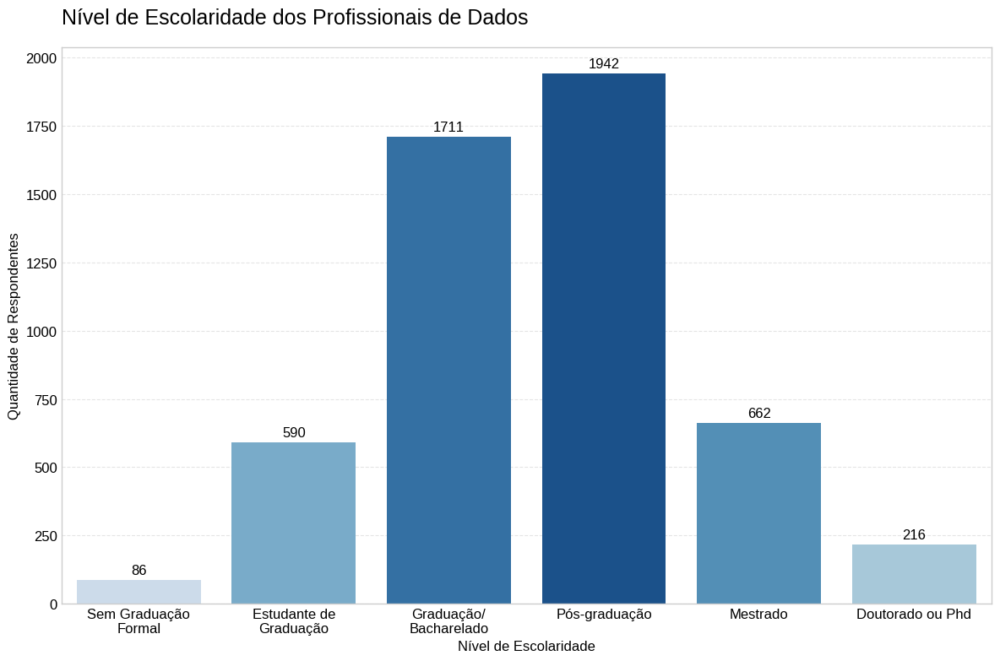

In [31]:
# Preparamos os dados para o gráfico
contagem_ordenada_escolaridade = df['1.l_nivel_de_ensino'].value_counts().reindex(ORDEM_ESCOLARIDADE, fill_value=0)

# Criamos a paleta de cores customizada
cores_para_escolaridade = criar_paleta_por_ranking(dataframe=df,coluna='1.l_nivel_de_ensino',ordem=ORDEM_ESCOLARIDADE)

# Geração do Gráfico
ax = sns.barplot(
    x=contagem_ordenada_escolaridade.index,
    y=contagem_ordenada_escolaridade.values,
    palette=cores_para_escolaridade
)

# Títulos e rótulos
ax.set_title('Nível de Escolaridade dos Profissionais de Dados', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Nível de Escolaridade', fontsize=12)
ax.set_ylabel('Quantidade de Respondentes', fontsize=12)

# Aplicação da quebra de linha inteligente
novos_labels = [MAPA_QUEBRA_LINHA_ESCOLARIDADE.get(label.get_text(), label.get_text()) for label in ax.get_xticklabels()]
ax.set_xticklabels(novos_labels)

# Rótulos nas barras
ax.bar_label(ax.containers[0], size=12, padding=3)

plt.tight_layout()
plt.show()

### Distribuição dos Cargos Principais

Nossa primeira análise de carreira será sobre a função de atuação dos respondentes. Graças à nossa etapa de engenharia de features, onde padronizamos os nomes dos cargos, podemos criar uma visualização limpa para entender qual é a proporção de Analistas, Engenheiros, Cientistas de Dados e outros profissionais no ecossistema.

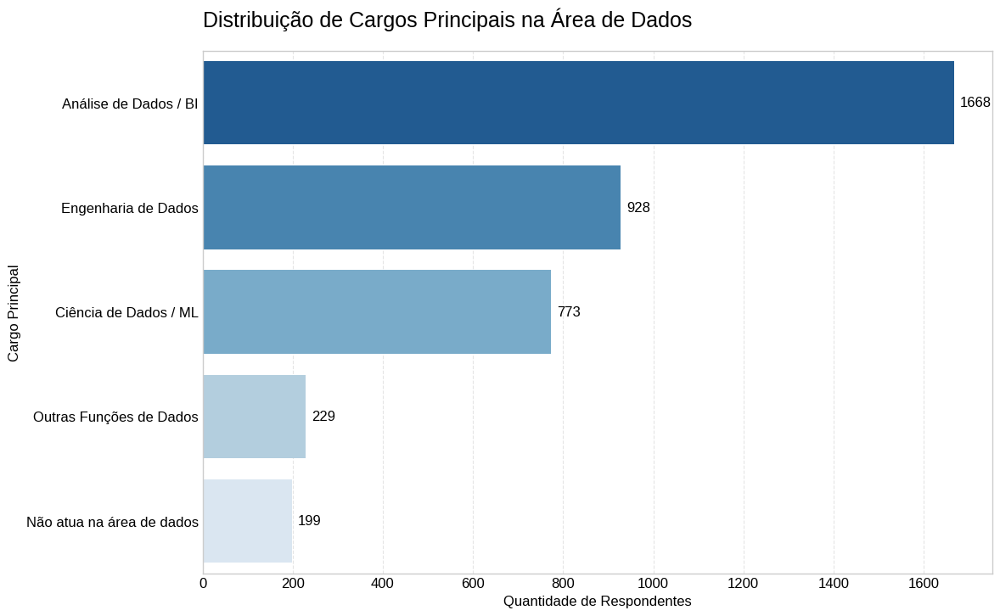

In [32]:
# Preparamos os dados para o eixo Y.
contagem_cargos = df['cargo_principal'].value_counts(dropna=False)

# Geração do gráfico
ax = sns.barplot(x=contagem_cargos.values,y=contagem_cargos.index,palette=PALETA_PRINCIPAL_REVERSA)

# Títulos e rótulos
ax.set_title('Distribuição de Cargos Principais na Área de Dados', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Quantidade de Respondentes', fontsize=12)
ax.set_ylabel('Cargo Principal', fontsize=12)

# Rótulos nas Barras
ax.bar_label(ax.containers[0], size=12, padding=5)

plt.show()

### Distribuição por Nível de Senioridade

Após entendermos a formação e os cargos, vamos analisar a distribuição de senioridade. Isso nos ajuda a visualizar a estrutura de experiência do mercado de dados: há mais profissionais em início de carreira ou o mercado já possui uma base sênior bem estabelecida?

Para esta visualização, manteremos nosso padrão: as barras serão ordenadas pela progressão de carreira (de Júnior a Gestor), e as cores destacarão os níveis com maior quantidade de profissionais.

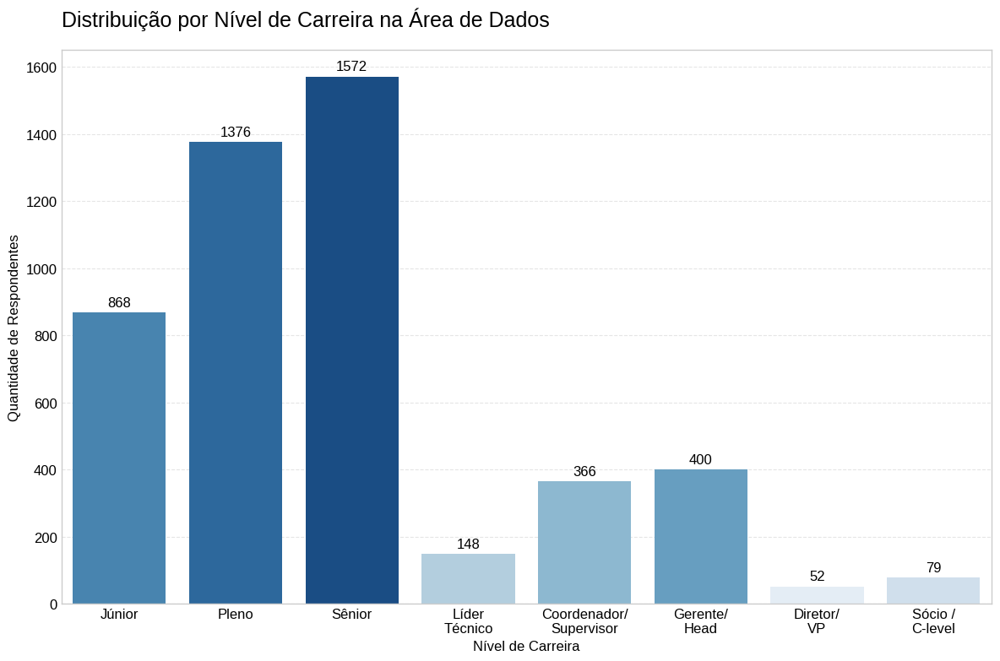

In [33]:
# A preparação dos dados permanece a mesma
contagem_carreira = df['nivel_carreira'].value_counts().reindex(ORDEM_SENIORIDADE, fill_value=0)
cores_para_carreira = criar_paleta_por_ranking(dataframe=df,coluna='nivel_carreira',ordem=ORDEM_SENIORIDADE)

# Geração do gráfico
ax = sns.barplot(
    x=contagem_carreira.index,
    y=contagem_carreira.values,
    palette=cores_para_carreira
)

# Aplicação da quebra de linha usando a constante global
# Pegamos os rótulos atuais e aplicamos nosso mapa
novos_labels = [MAPA_QUEBRA_LINHA.get(label.get_text(), label.get_text()) for label in ax.get_xticklabels()]
ax.set_xticklabels(novos_labels)

# Títulos e rótulos
ax.set_title('Distribuição por Nível de Carreira na Área de Dados', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Nível de Carreira', fontsize=12)
ax.set_ylabel('Quantidade de Respondentes', fontsize=12)

# Rótulos nas barras
ax.bar_label(ax.containers[0], size=12, padding=3)

plt.tight_layout()
plt.show()

### Análise de Salário por Nível de Carreira

Com uma base sólida sobre o perfil dos profissionais, iniciamos a análise bivariada para entender como as variáveis se relacionam. A primeira e mais importante relação a ser investigada é o impacto do nível de carreira na remuneração.

Utilizando um Box Plot, vamos visualizar a distribuição dos salários para cada nível de senioridade, desde Júnior até a gestão. Isso nos permitirá não apenas comparar as medianas salariais, mas também entender a dispersão dos salários e a presença de valores atípicos em cada nível.

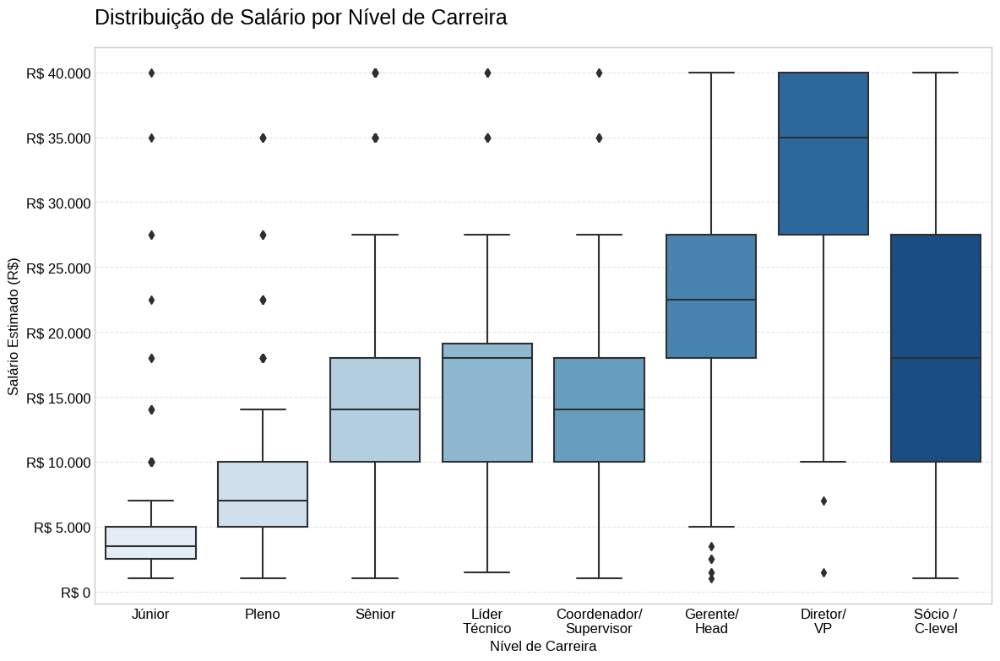

In [34]:
ax = sns.boxplot(data=df,x='nivel_carreira',y='salario_estimado_numerico',order=ORDEM_SENIORIDADE,palette=PALETA_PRINCIPAL)

# Quebra de linha que foi definido na célula de configurações.
novos_labels = [MAPA_QUEBRA_LINHA.get(label.get_text(), label.get_text()) for label in ax.get_xticklabels()]
ax.set_xticklabels(novos_labels)

# Títulos e rótulos
ax.set_title('Distribuição de Salário por Nível de Carreira', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Nível de Carreira', fontsize=12)
ax.set_ylabel('Salário Estimado (R$)', fontsize=12)

# Formatando o eixo Y para exibir os valores em formato de moeda
ax.get_yaxis().set_major_formatter(FuncFormatter(lambda x, p: f'R$ {int(x):,d}'.replace(',', '.')))

plt.tight_layout()
plt.show()

### Análise de Salário por Cargo Principal

Após verificarmos o impacto da senioridade, vamos analisar como a função principal (Analista, Cientista, Engenheiro) se relaciona com a remuneração. Este é um dos cruzamentos mais importantes para entender a valorização de cada especialidade no mercado de dados.

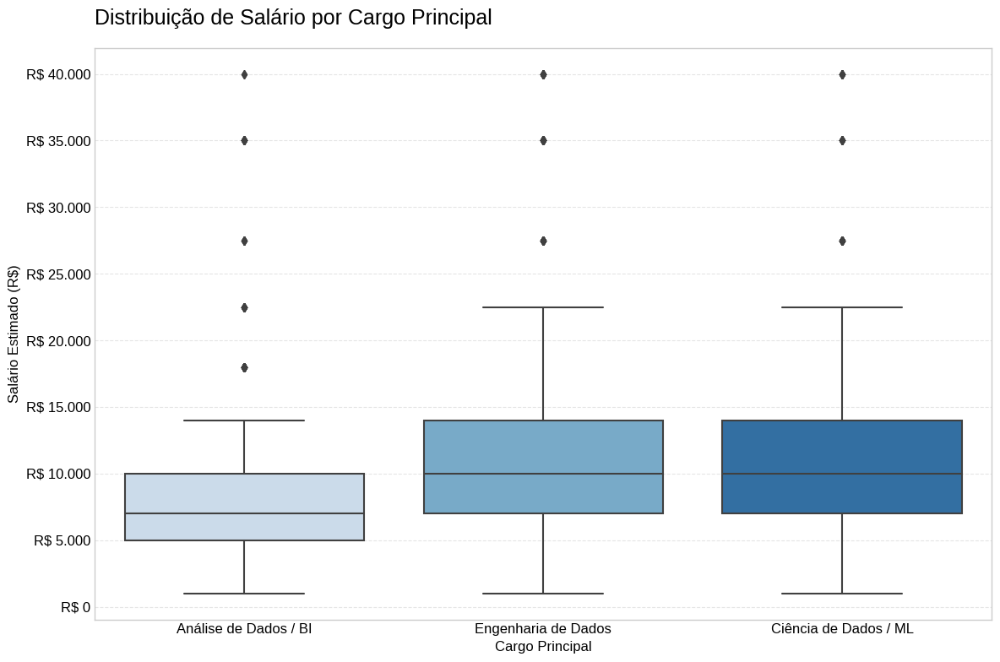

In [35]:
# Filtramos os dados para incluir apenas os cargos principais e remover outros casos para uma visualização mais limpa.
cargos_principais = ['Análise de Dados / BI', 'Engenharia de Dados', 'Ciência de Dados / ML']
df_cargos = df[df['cargo_principal'].isin(cargos_principais)]

# Geração do gráfico
ax = sns.boxplot(data=df_cargos,x='cargo_principal',y='salario_estimado_numerico',palette=PALETA_PRINCIPAL)

# Títulos e rótulos
ax.set_title('Distribuição de Salário por Cargo Principal', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Cargo Principal', fontsize=12)
ax.set_ylabel('Salário Estimado (R$)', fontsize=12)

# Formatando o eixo Y para exibir os valores em formato de moeda
from matplotlib.ticker import FuncFormatter
ax.get_yaxis().set_major_formatter(FuncFormatter(lambda x, p: f'R$ {int(x):,d}'.replace(',', '.')))

plt.tight_layout()
plt.show()

### Análise de Salário vs. Experiência em Dados

Uma das análises mais importantes é entender como a remuneração evolui com o tempo de experiência. Um profissional com mais anos de trabalho na área de dados tem, de fato, um salário maior? E essa progressão é a mesma para todas as funções?

Para investigar isso, utilizaremos um gráfico de dispersão, plotando o salário estimado contra os anos de experiência. Adicionaremos também uma linha de tendência (regressão linear) para visualizar a relação geral e separaremos por cor os diferentes cargos principais.

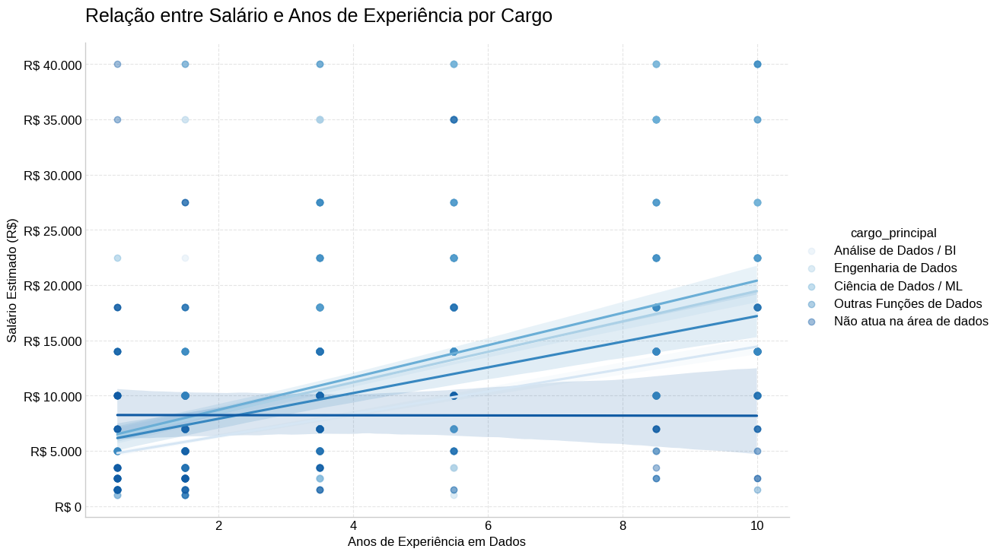

In [36]:
# A função lmplot é um pouco diferente e não usa o 'ax' da mesma forma,mas ainda podemos simplificá-la.
sns.lmplot(
    data=df.dropna(subset=['salario_estimado_numerico', 'experiencia_em_dados_anos', 'cargo_principal']),
    x='experiencia_em_dados_anos',
    y='salario_estimado_numerico',
    hue='cargo_principal',
    palette=PALETA_PRINCIPAL, # <<< Usando nossa constante
    height=7,
    aspect=1.5,
    scatter_kws={'alpha':0.4}
)

# Para o lmplot, definimos os títulos e rótulos desta forma
plt.title('Relação entre Salário e Anos de Experiência por Cargo', fontsize=18, loc='left', pad=20)
plt.xlabel('Anos de Experiência em Dados', fontsize=12)
plt.ylabel('Salário Estimado (R$)', fontsize=12)

# Formatando o eixo Y para o formato de moeda
from matplotlib.ticker import FuncFormatter
ax = plt.gca()
ax.get_yaxis().set_major_formatter(FuncFormatter(lambda x, p: f'R$ {int(x):,d}'.replace(',', '.')))

plt.show()

### Análise Cruzada: Salário por Nível de Carreira e Cargo Principal

Este é um dos pontos centrais da nossa análise. Aqui, vamos cruzar três das nossas variáveis mais importantes para criar uma visão completa da remuneração no mercado de dados. O objetivo é comparar lado a lado a progressão salarial de Analistas, Cientistas e Engenheiros de Dados em cada etapa da carreira, do Júnior ao Sênior.

Isso nos permitirá confirmar visualmente não apenas que o salário aumenta com a senioridade, mas também *o quão diferente* é essa progressão para cada função.

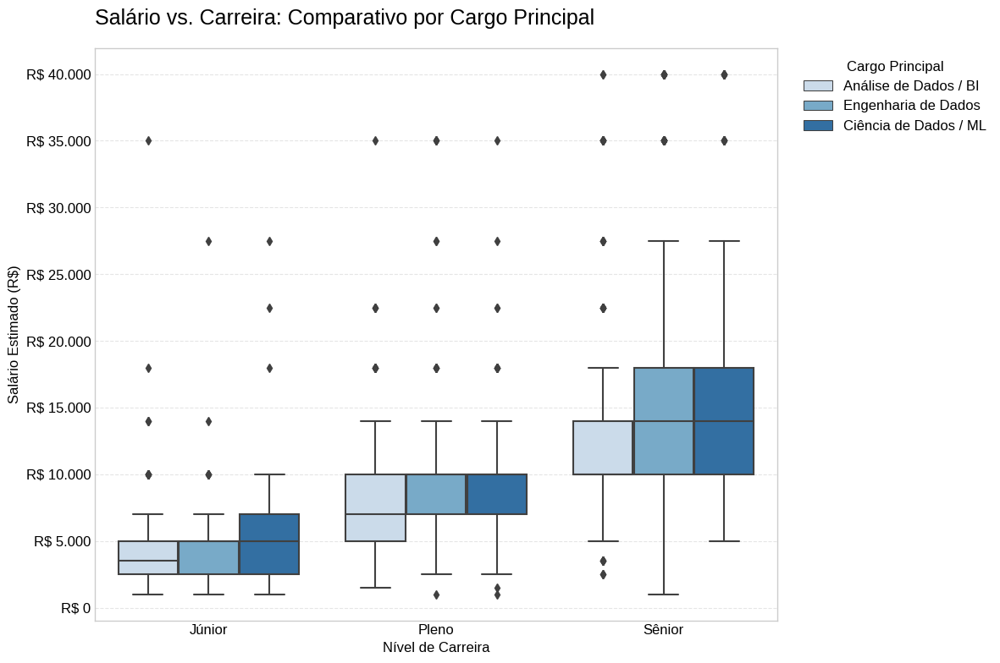

In [37]:
# Filtramos os dados
cargos_principais = ['Análise de Dados / BI', 'Engenharia de Dados', 'Ciência de Dados / ML']
niveis_contribuidores = ['Júnior', 'Pleno', 'Sênior']

df_plot = df[df['cargo_principal'].isin(cargos_principais) & df['nivel_carreira'].isin(niveis_contribuidores)]

# Geração do gráfico
ax = sns.boxplot(data=df_plot,x='nivel_carreira',
    y='salario_estimado_numerico',
    hue='cargo_principal',
    order=niveis_contribuidores,  
    palette=PALETA_PRINCIPAL
)

# Títulos e rótulos
ax.set_title('Salário vs. Carreira: Comparativo por Cargo Principal', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Nível de Carreira', fontsize=12)
ax.set_ylabel('Salário Estimado (R$)', fontsize=12)

# Formatando o eixo Y
ax.get_yaxis().set_major_formatter(FuncFormatter(lambda x, p: f'R$ {int(x):,d}'.replace(',', '.')))

#Legenda
plt.legend(title='Cargo Principal', bbox_to_anchor=(1.02, 1), loc='upper left')

plt.tight_layout()
plt.show()

### Relação entre Área de Formação e Cargo Principal

Para finalizar nossa análise sobre o impacto da formação na carreira, vamos investigar se a área de graduação de um profissional tem influência sobre a função que ele exerce hoje. Profissionais formados em Computação tendem a se tornar mais Engenheiros de Dados? E os formados em Negócios, mais Analistas? Este gráfico nos ajudará a visualizar essas tendências.

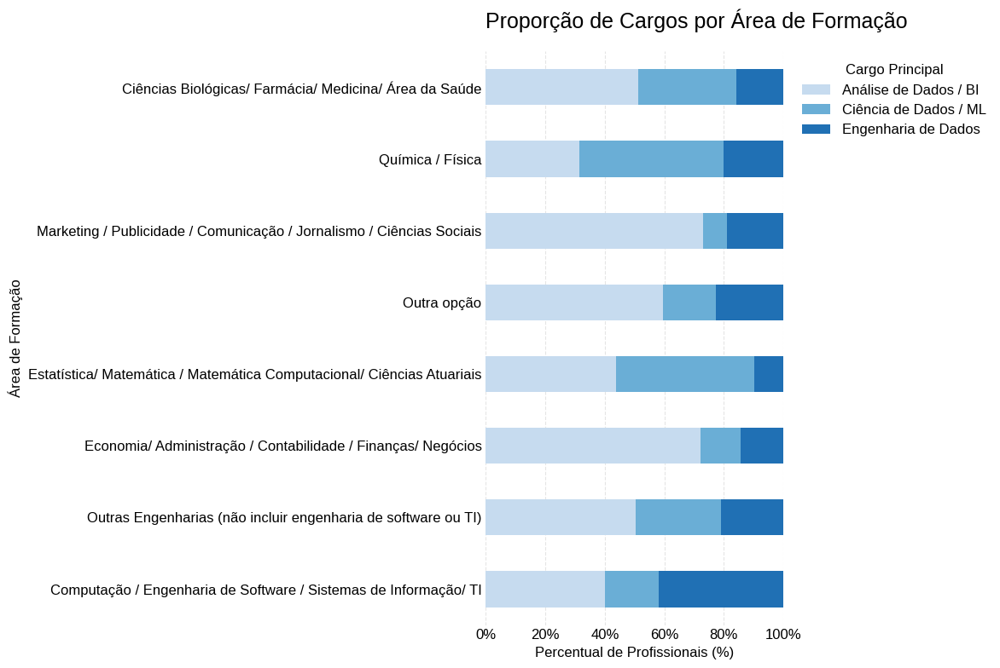

In [38]:
# Filtramos para os principais cargos para manter o gráfico limpo.
cargos_principais = ['Análise de Dados / BI', 'Engenharia de Dados', 'Ciência de Dados / ML']
df_plot = df[df['cargo_principal'].isin(cargos_principais)].copy()

# Agrupamos por área de formação e contamos a proporção de cada cargo.
tabela_proporcao = pd.crosstab(df_plot['1.m_área_de_formação'], df_plot['cargo_principal'], normalize='index') * 100

# Ordenamos pela área de formação com mais respondentes para uma melhor visualização
ordem_formacao = df_plot['1.m_área_de_formação'].value_counts().index
tabela_proporcao = tabela_proporcao.loc[ordem_formacao]

# Geração do gráfico de barras empilhadas 100%
ax = tabela_proporcao.plot(
    kind='barh',
    stacked=True,
    color=sns.color_palette(PALETA_PRINCIPAL, n_colors=len(cargos_principais)) # Usando nossa paleta
)

# Títulos e rótulos
ax.set_title('Proporção de Cargos por Área de Formação', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Percentual de Profissionais (%)', fontsize=12)
ax.set_ylabel('Área de Formação', fontsize=12)

# Melhorando a legenda e colocando-a fora do gráfico
plt.legend(title='Cargo Principal', bbox_to_anchor=(1.02, 1), loc='upper left')

# Adicionando um rótulo de 100% ao final do eixo x para clareza
ax.xaxis.set_major_formatter(plt.FuncFormatter('{:.0f}%'.format))
plt.xlim(0, 100)

# Removemos as bordas para um visual mais limpo
sns.despine(left=True, bottom=True)

plt.tight_layout()
plt.show()

### Relação entre Nível de Escolaridade e Salário

Continuando a investigação sobre o impacto da formação, vamos agora cruzar o nível de instrução dos profissionais com seu salário estimado. O objetivo é visualizar se um grau acadêmico mais elevado tem uma correlação positiva e significativa com o potencial de ganho no mercado de dados.

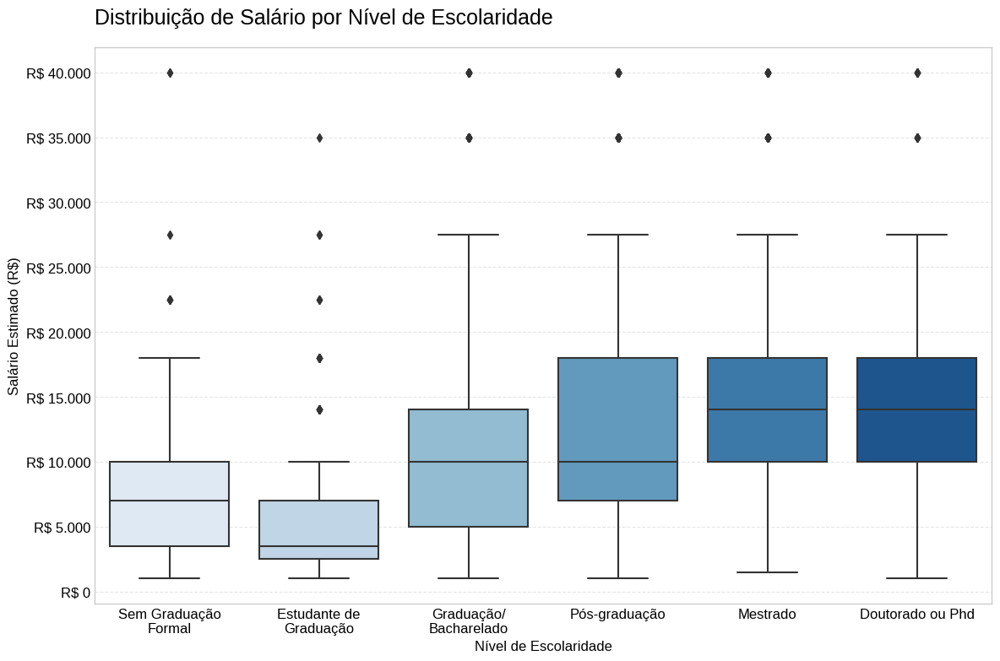

In [39]:
ax = sns.boxplot(data=df,x='1.l_nivel_de_ensino',y='salario_estimado_numerico',order=ORDEM_ESCOLARIDADE,palette=PALETA_PRINCIPAL)

# Usamos a nossa constante MAPA_QUEBRA_LINHA_ESCOLARIDADE
novos_labels = [MAPA_QUEBRA_LINHA_ESCOLARIDADE.get(label.get_text(), label.get_text()) for label in ax.get_xticklabels()]
ax.set_xticklabels(novos_labels, ha='center') 

# Títulos e rótulos
ax.set_title('Distribuição de Salário por Nível de Escolaridade', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Nível de Escolaridade', fontsize=12)
ax.set_ylabel('Salário Estimado (R$)', fontsize=12)

# Formatando o eixo Y
ax.get_yaxis().set_major_formatter(FuncFormatter(lambda x, p: f'R$ {int(x):,d}'.replace(',', '.')))

plt.tight_layout()
plt.show()

## **Análise de Ferramentas e Tecnologias**

Após entendermos o perfil demográfico e de carreira, vamos agora investigar o arsenal de ferramentas que os profissionais de dados utilizam. Nesta seção, analisaremos as linguagens de programação, bancos de dados e ferramentas de BI mais populares, entendendo quais tecnologias dominam o mercado.

### Linguagens de Programação Mais Utilizadas

Iniciamos esta seção analisando as linguagens de programação mais utilizadas no dia a dia. Como a pesquisa permite múltiplas respostas, agregaremos os dados para criar um ranking de popularidade.

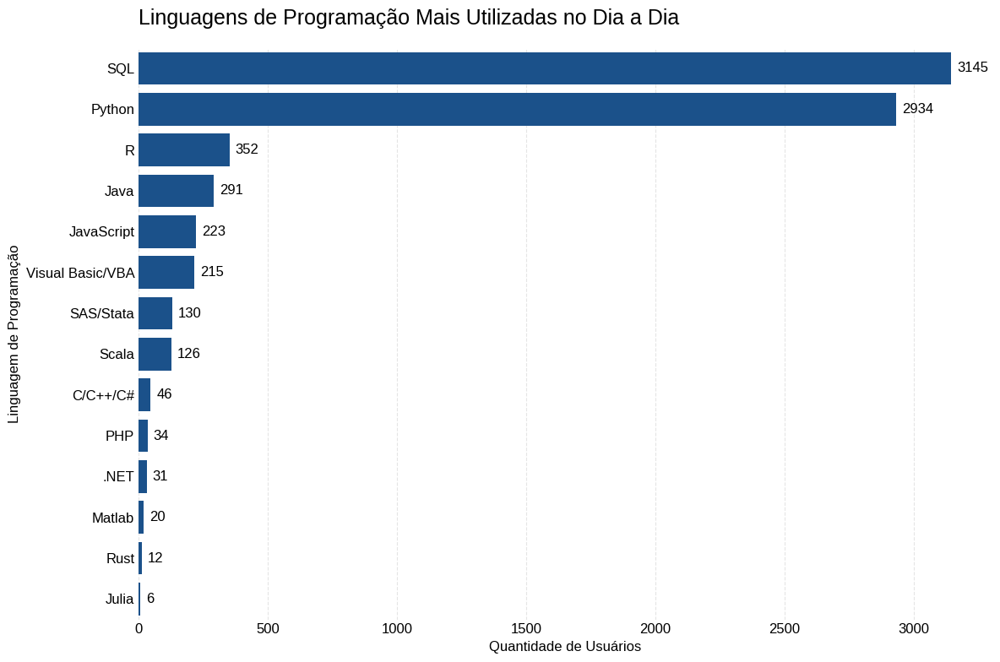

In [40]:
# Identificamos as colunas de linguagens (padrão '4.d.')
colunas_linguagens = [col for col in df.columns if col.startswith('4.d.')]

# Somamos as respostas para obter a contagem de usuários por linguagem
contagem_linguagens = df[colunas_linguagens].sum().sort_values(ascending=False)

# Limpamos os nomes das colunas para usar como rótulos no gráfico
contagem_linguagens.index = contagem_linguagens.index.str.replace(r'4\.d\.\d{1,2}_', '', regex=True)

# Geração do Gráfico de Barras Horizontais
ax = sns.barplot(
    x=contagem_linguagens.values,
    y=contagem_linguagens.index,
    color=COR_PRINCIPAL
)

# Títulos e rótulos
ax.set_title('Linguagens de Programação Mais Utilizadas no Dia a Dia', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Quantidade de Usuários', fontsize=12)
ax.set_ylabel('Linguagem de Programação', fontsize=12)

# Adicionando os valores nas barras
ax.bar_label(ax.containers[0], size=12, padding=5)

# Removemos as bordas para um visual mais limpo
sns.despine(left=True, bottom=True)

plt.tight_layout()
plt.show()

### Bancos de Dados Mais Utilizados

Depois das linguagens, os bancos de dados são o principal local de trabalho de um profissional de dados. Nesta análise, vamos identificar quais tecnologias de banco de dados, desde os relacionais tradicionais até as modernas soluções em nuvem, são as mais presentes no cotidiano dos respondentes.

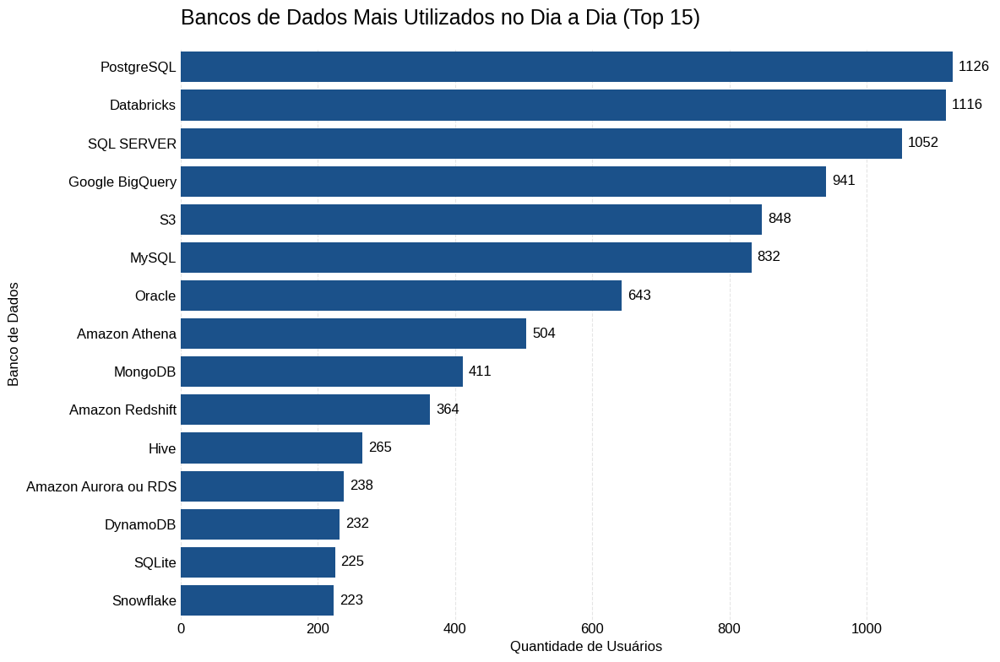

In [41]:
# Identificamos as colunas de bancos de dados (padrão '4.g.')
colunas_bancos = [col for col in df.columns if col.startswith('4.g.')]

# Somamos as respostas para obter a contagem total de usuários por tecnologia.
contagem_bancos = df[colunas_bancos].sum().sort_values(ascending=False).head(15) # Pegamos o Top 15

# Limpamos os nomes das colunas para usar como rótulos no gráfico.
contagem_bancos.index = contagem_bancos.index.str.replace(r'4\.g\.\d{1,2}_', '', regex=True)

# Geração do gráfico
ax = sns.barplot(
    x=contagem_bancos.values,
    y=contagem_bancos.index,
    color=COR_PRINCIPAL # Usando nossa cor padrão
)

# Títulos e rótulos
ax.set_title('Bancos de Dados Mais Utilizados no Dia a Dia (Top 15)', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Quantidade de Usuários', fontsize=12)
ax.set_ylabel('Banco de Dados', fontsize=12)

# Adicionando os valores nas barras
ax.bar_label(ax.containers[0], size=12, padding=5)

sns.despine(left=True, bottom=True)

plt.tight_layout()
plt.show()

### Ferramentas de BI mais utilizadas

As ferramentas de Business Intelligence (BI) são cruciais para a criação de dashboards, relatórios e visualizações que comunicam os insights de dados para as áreas de negócio. Nesta análise, vamos identificar quais plataformas, como Power BI, Tableau e Looker, dominam o dia a dia dos profissionais.

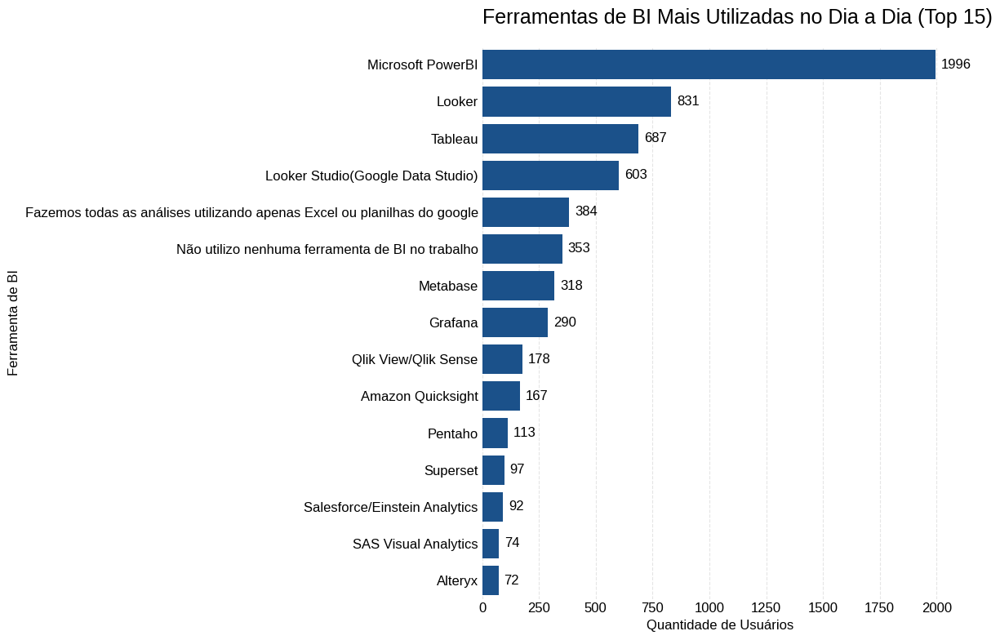

In [42]:
# Identificamos as colunas de ferramentas de BI (padrão '4.j.')
colunas_bi = [col for col in df.columns if col.startswith('4.j.')]

# Somamos as respostas para obter a contagem de usuários por ferramenta.
# Pegamos o Top 15 para focar nas mais relevantes.
contagem_bi = df[colunas_bi].sum().sort_values(ascending=False).head(15)

# Limpamos os nomes das colunas para usar como rótulos no gráfico.
contagem_bi.index = contagem_bi.index.str.replace(r'4\.j\.\d{1,2}_', '', regex=True)

# Geração do Gráfico de Barras Horizontais
ax = sns.barplot(
    x=contagem_bi.values,
    y=contagem_bi.index,
    color=COR_PRINCIPAL
)

# Títulos e rótulos
ax.set_title('Ferramentas de BI Mais Utilizadas no Dia a Dia (Top 15)', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Quantidade de Usuários', fontsize=12)
ax.set_ylabel('Ferramenta de BI', fontsize=12)

ax.bar_label(ax.containers[0], size=12, padding=5)

sns.despine(left=True, bottom=True)

plt.tight_layout()
plt.show()

### Plataformas de cloud mais utilizadas

Fechando nossa análise sobre o ecossistema de tecnologias, vamos investigar quais são os provedores de nuvem mais populares entre os profissionais de dados no Brasil. A predominância de uma ou mais plataformas indica as habilidades mais demandadas pelo mercado em termos de infraestrutura.

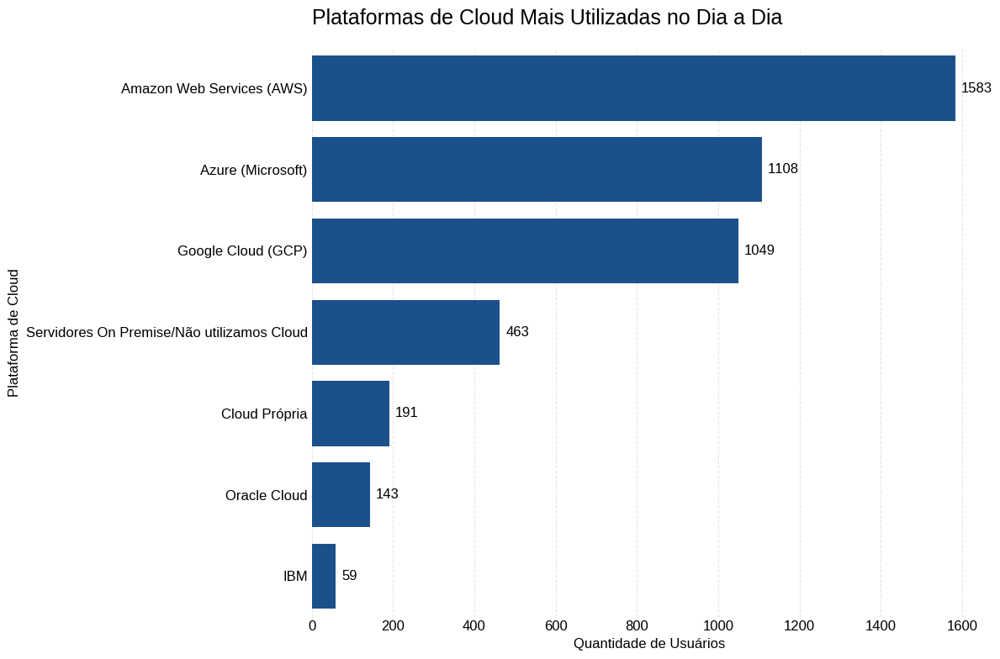

In [43]:
# Identificamos as colunas de plataformas de cloud (padrão '4.h.')
colunas_cloud = [col for col in df.columns if col.startswith('4.h.')]

# Somamos as respostas para obter a contagem de usuários por plataforma.
contagem_cloud = df[colunas_cloud].sum().sort_values(ascending=False)

# Limpamos os nomes das colunas para usar como rótulos no gráfico.
contagem_cloud.index = contagem_cloud.index.str.replace(r'4\.h\.\d{1,2}_', '', regex=True)

# Geração do gráfico
ax = sns.barplot(
    x=contagem_cloud.values,
    y=contagem_cloud.index,
    color=COR_PRINCIPAL 
)

# Títulos e rótulos
ax.set_title('Plataformas de Cloud Mais Utilizadas no Dia a Dia', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Quantidade de Usuários', fontsize=12)
ax.set_ylabel('Plataforma de Cloud', fontsize=12)

ax.bar_label(ax.containers[0], size=12, padding=5)

sns.despine(left=True, bottom=True)

plt.tight_layout()
plt.show()

## **Análise da Gestão: Desafios e Responsabilidades**

Após entendermos o cenário geral, vamos agora focar em um segmento específico e crucial: os gestores. Nesta seção, vamos analisar os principais desafios que os líderes de times de dados enfrentam no dia a dia e suas responsabilidades.

### Desafios da Gestão

Após entendermos o perfil, a carreira e as ferramentas dos profissionais, vamos agora focar em um segmento específico e crucial: os gestores. Nesta seção, vamos analisar os principais desafios que os líderes de times de dados enfrentam no dia a dia, com base nas respostas da Parte 3 do questionário.

Analisando os desafios de 1045 respondentes em cargos de gestão.


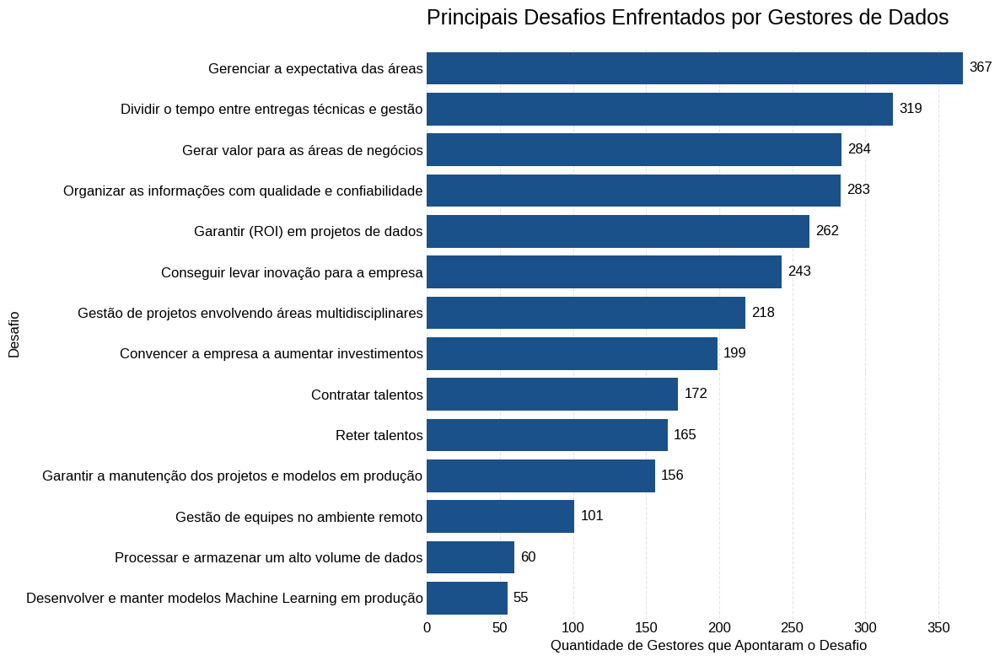

In [44]:
# Primeiro, filtramos nosso dataframe para incluir apenas os respondentes que são gestores.
niveis_gestao = [
    'Líder Técnico',
    'Coordenador/Supervisor',
    'Gerente/Head',
    'Diretor/VP',
    'Sócio / C-level'
]
df_gestores = df[df['nivel_carreira'].isin(niveis_gestao)].copy()

print(f"Analisando os desafios de {len(df_gestores)} respondentes em cargos de gestão.")

# Identificamos as colunas relacionadas aos desafios (usando o prefixo correto '3.d.')
colunas_desafios = [col for col in df.columns if col.startswith('3.d.')] # <<< CORREÇÃO AQUI

# Somamos as respostas para obter a contagem de cada desafio.
contagem_desafios = df_gestores[colunas_desafios].sum().sort_values(ascending=False)

# Limpamos os nomes das colunas para usar como rótulos no gráfico.
contagem_desafios.index = contagem_desafios.index.str.replace(r'3\.d\.\d{1,2}_', '', regex=True)

# Geração do gráfico
ax = sns.barplot(
    x=contagem_desafios.values,
    y=contagem_desafios.index,
    color=COR_PRINCIPAL 
)

# Títulos e rótulos
ax.set_title('Principais Desafios Enfrentados por Gestores de Dados', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Quantidade de Gestores que Apontaram o Desafio', fontsize=12)
ax.set_ylabel('Desafio', fontsize=12)

ax.bar_label(ax.containers[0], size=12, padding=5)

sns.despine(left=True, bottom=True)

plt.tight_layout()
plt.show()

### Principais responsabilidades dos gestores de dados

Após entendermos os principais desafios, vamos agora analisar quais são as responsabilidades mais comuns no dia a dia de um líder de dados. Isso nos ajuda a entender o foco do trabalho de gestão: é mais estratégico, focado em pessoas, ou ainda muito técnico?

Analisando as responsabilidades de 1045 respondentes em cargos de gestão.


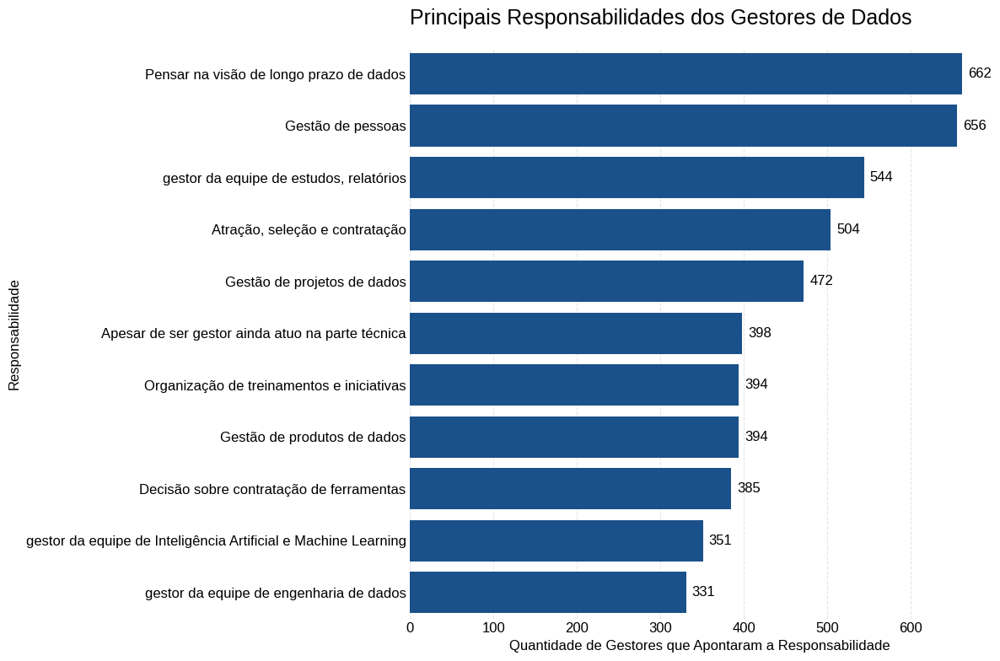

In [45]:
# Usamos o mesmo dataframe 'df_gestores' que já filtramos anteriormente.
print(f"Analisando as responsabilidades de {len(df_gestores)} respondentes em cargos de gestão.")

# Identificamos as colunas relacionadas às responsabilidades (padrão '3.c.')
colunas_responsabilidades = [col for col in df.columns if col.startswith('3.c.')]

# Somamos as respostas para obter a contagem de cada responsabilidade.
contagem_responsabilidades = df_gestores[colunas_responsabilidades].sum().sort_values(ascending=False)

# Limpamos os nomes das colunas para usar como rótulos no gráfico.
contagem_responsabilidades.index = contagem_responsabilidades.index.str.replace(r'3\.c\.\d{1,2}_', '', regex=True)

# Geração do gráfico
ax = sns.barplot(
    x=contagem_responsabilidades.values,
    y=contagem_responsabilidades.index,
    color=COR_PRINCIPAL # Usando nossa cor padrão
)

# Títulos e rótulos
ax.set_title('Principais Responsabilidades dos Gestores de Dados', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Quantidade de Gestores que Apontaram a Responsabilidade', fontsize=12)
ax.set_ylabel('Responsabilidade', fontsize=12)

ax.bar_label(ax.containers[0], size=12, padding=5)

sns.despine(left=True, bottom=True)

plt.tight_layout()
plt.show()

### Visão dos gestores sobre IA Generativa

Um dos temas mais relevantes do relatório é a adoção de IA Generativa. Nesta análise, vamos focar especificamente na visão dos gestores: para eles, esta tecnologia é uma prioridade estratégica para o time de dados?

Analisando a visão sobre IA de 1045 respondentes em cargos de gestão.


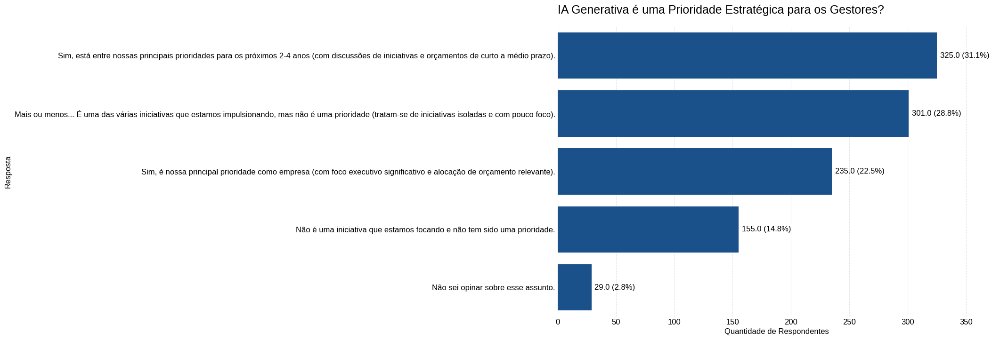

In [46]:
# Usamos o mesmo dataframe 'df_gestores' que já filtramos.
print(f"Analisando a visão sobre IA de {len(df_gestores)} respondentes em cargos de gestão.")

# Contamos as respostas da coluna '3.e_ai_generativa_e_llm_é_uma_prioridade?'.
contagem_ia_prioridade = df_gestores['3.e_ai_generativa_e_llm_é_uma_prioridade?'].value_counts()

# Geração do Gráfico de Barras Horizontais (alternativa ao gráfico de pizza)
ax = sns.barplot(
    x=contagem_ia_prioridade.values,
    y=contagem_ia_prioridade.index,
    color=COR_PRINCIPAL
)

# Títulos e rótulos
ax.set_title('IA Generativa é uma Prioridade Estratégica para os Gestores?', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Quantidade de Respondentes', fontsize=12)
ax.set_ylabel('Resposta', fontsize=12)

# Adicionando os valores e a porcentagem nas barras para maior clareza
total = len(df_gestores) # Usamos o total de gestores para calcular a %
for container in ax.containers:
    labels = [f'{v.get_width()} ({v.get_width()/total*100:,.1f}%)' for v in container]
    ax.bar_label(container, labels=labels, size=12, padding=5)

sns.despine(left=True, bottom=True)
ax.set_xlim(right=ax.get_xlim()[1] * 1.1) # Aumenta o espaço para os rótulos

plt.tight_layout()
plt.show()

## **Análise de Objetivos de Carreira**

Após analisarmos o perfil, a carreira e os desafios dos profissionais (incluindo o foco nos gestores), vamos agora focar no futuro: o que eles buscam? Nesta seção, investigaremos suas motivações e os critérios que consideram mais importantes ao planejar seus próximos passos profissionais.

### Critérios para escolha de um novo emprego

Começamos analisando os fatores decisivos para um profissional aceitar uma nova proposta de trabalho. [cite_start]O relatório oficial da Bain & Company e Data Hackers aponta que a remuneração se tornou o critério mais importante[cite: 46], superando a flexibilidade. Vamos visualizar o ranking completo desses critérios.

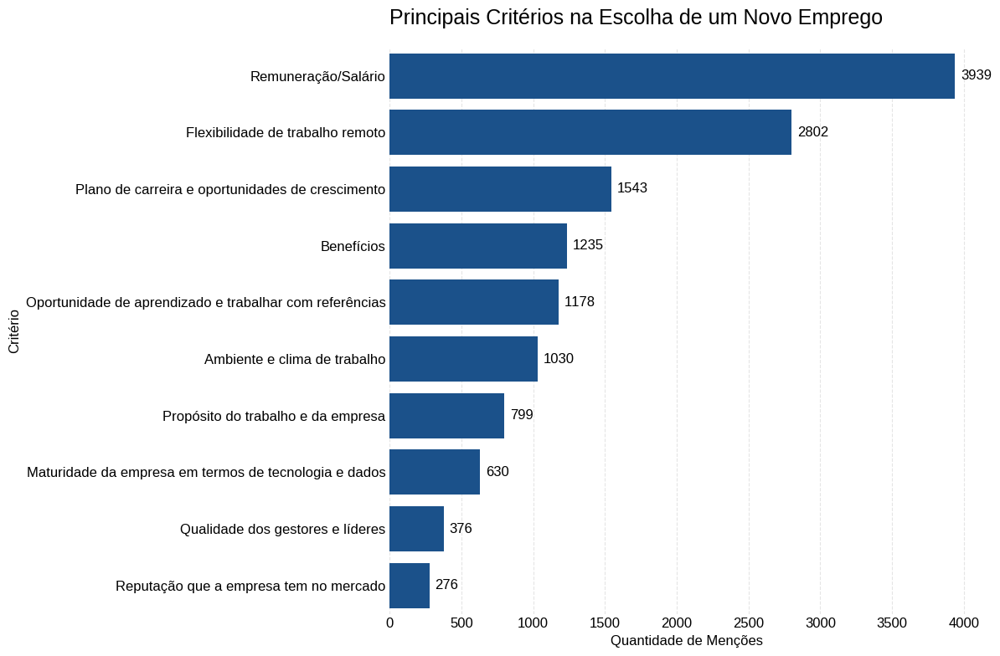

In [47]:
# Identificamos as colunas relacionadas aos critérios de escolha (padrão '2.o.')
colunas_criterios = [col for col in df.columns if col.startswith('2.o.')]

# Somamos as respostas para obter a contagem de cada critério.
contagem_criterios = df[colunas_criterios].sum().sort_values(ascending=False)

# Limpamos os nomes das colunas para usar como rótulos no gráfico.
contagem_criterios.index = contagem_criterios.index.str.replace(r'2\.o\.\d{1,2}_', '', regex=True)

# Geração do gráfico
ax = sns.barplot(
    x=contagem_criterios.values,
    y=contagem_criterios.index,
    color=COR_PRINCIPAL # Usando nossa cor padrão
)

# Títulos e rótulos
ax.set_title('Principais Critérios na Escolha de um Novo Emprego', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Quantidade de Menções', fontsize=12)
ax.set_ylabel('Critério', fontsize=12)

ax.bar_label(ax.containers[0], size=12, padding=5)

sns.despine(left=True, bottom=True)

plt.tight_layout()
plt.show()

### Análise de critérios de emprego por nível de carreira

Já vimos os critérios mais importantes de forma geral. Agora, vamos aprofundar a análise para entender se as prioridades mudam de acordo com o nível de experiência do profissional. O que um Júnior busca em um emprego é o mesmo que um Sênior ou um Gestor? Esta análise segmentada pode revelar insights valiosos sobre as motivações em cada fase da carreira.

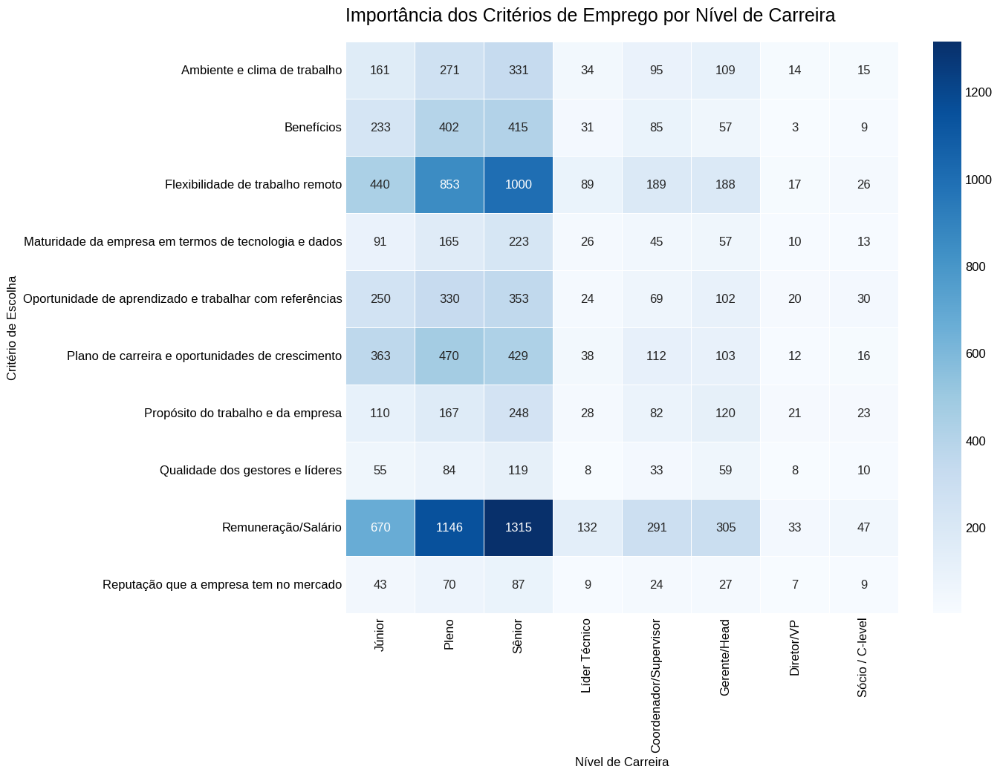

In [48]:
# A preparação inicial dos dados é a mesma até a contagem agrupada.
colunas_criterios = [col for col in df.columns if col.startswith('2.o.')]
df_criterios = df[colunas_criterios + ['nivel_carreira']].copy()
df_criterios.columns = df_criterios.columns.str.replace(r'2\.o\.\d{1,2}_', '', regex=True)
df_long = df_criterios.melt(id_vars=['nivel_carreira'], var_name='criterio', value_name='contagem')
contagem_agrupada = df_long.groupby(['nivel_carreira', 'criterio'])['contagem'].sum().reset_index()

#Para o heatmap, precisamos "pivotar" a tabela.
# Queremos os critérios nas linhas, os níveis nas colunas e a contagem como valores.
heatmap_data = contagem_agrupada.pivot_table(
    index='criterio', 
    columns='nivel_carreira', 
    values='contagem'
)

# Reordenamos as colunas para seguir nossa ordem de senioridade padrão e preenchemos valores nulos com 0.
heatmap_data = heatmap_data.reindex(columns=ORDEM_SENIORIDADE).fillna(0)

# Geração do Heatmap
plt.figure(figsize=(12, 10))
ax = sns.heatmap(
    heatmap_data,
    annot=True, # Adiciona os números dentro de cada célula
    fmt=".0f",  # Formata os números como inteiros
    linewidths=.5,
    cmap=PALETA_PRINCIPAL # Usando nossa paleta de azuis
)

# Títulos e rótulos
ax.set_title('Importância dos Critérios de Emprego por Nível de Carreira', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Nível de Carreira', fontsize=12)
ax.set_ylabel('Critério de Escolha', fontsize=12)

plt.show()

### Principais motivações para mudar de emprego

Para complementar nossa análise de objetivos, vamos investigar os principais motivos que levam os profissionais a buscar uma nova posição. Entender os fatores de insatisfação no trabalho atual nos dá uma visão clara dos "pontos de dor" do mercado.

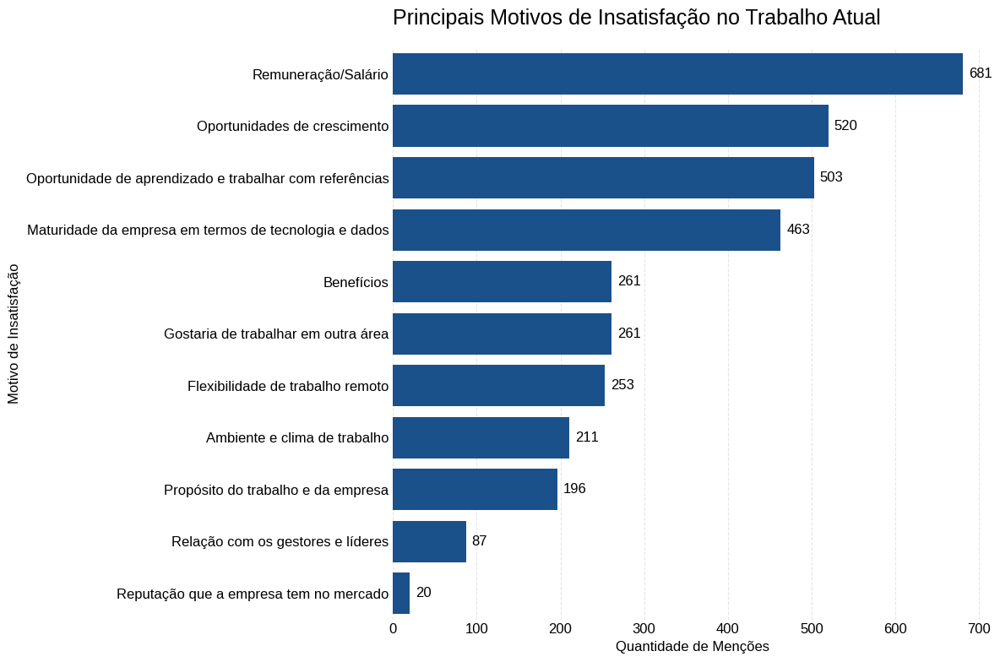

In [49]:
# Identificamos as colunas relacionadas aos motivos de insatisfação (usando o prefixo correto '2.l.')
colunas_motivacoes = [col for col in df.columns if col.startswith('2.l.')] # <<< CORREÇÃO AQUI

# Somamos as respostas para obter a contagem de cada motivação.
contagem_motivacoes = df[colunas_motivacoes].sum().sort_values(ascending=False)

# Limpamos os nomes das colunas para usar como rótulos no gráfico.
contagem_motivacoes.index = contagem_motivacoes.index.str.replace(r'2\.l\.\d{1,2}_', '', regex=True)

# Geração do gráfico
ax = sns.barplot(
    x=contagem_motivacoes.values,
    y=contagem_motivacoes.index,
    color=COR_PRINCIPAL # Usando nossa cor padrão
)

# Títulos e rótulos
ax.set_title('Principais Motivos de Insatisfação no Trabalho Atual', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Quantidade de Menções', fontsize=12)
ax.set_ylabel('Motivo de Insatisfação', fontsize=12)

ax.bar_label(ax.containers[0], size=12, padding=5)

sns.despine(left=True, bottom=True)

plt.tight_layout()
plt.show()

### Análise de motivos de insatisfação por nível de carreira

Para aprofundar nosso entendimento sobre as motivações dos profissionais, vamos agora segmentar os principais motivos de insatisfação por nível de carreira. Esta análise pode revelar "dores" específicas de cada fase da trajetória profissional, mostrando se a falta de oportunidade de crescimento, por exemplo, é uma preocupação maior para profissionais em início de carreira ou para os mais experientes.

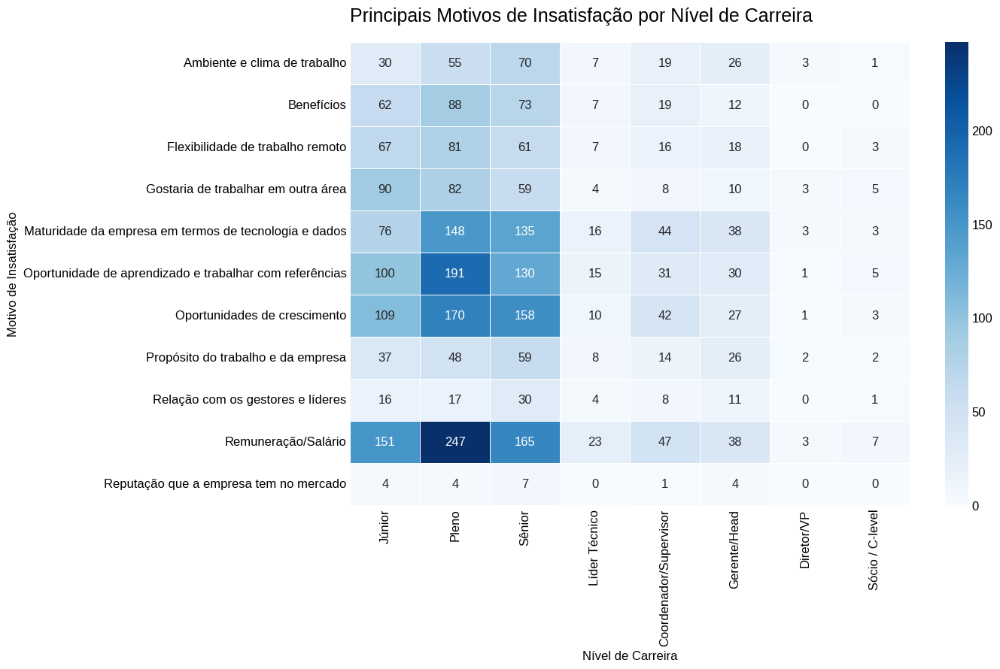

In [50]:
colunas_insatisfacao = [col for col in df.columns if col.startswith('2.l.')]
df_insatisfacao = df[colunas_insatisfacao + ['nivel_carreira']].copy()
df_insatisfacao.columns = df_insatisfacao.columns.str.replace(r'2\.l\.\d{1,2}_', '', regex=True)
df_long_insatisfacao = df_insatisfacao.melt(id_vars=['nivel_carreira'], var_name='motivo', value_name='contagem')
contagem_agrupada_ins = df_long_insatisfacao.groupby(['nivel_carreira', 'motivo'])['contagem'].sum().reset_index()

# Transformamos os dados para que os motivos virem linhas e os níveis de carreira virem colunas.
heatmap_data_ins = contagem_agrupada_ins.pivot_table(
    index='motivo', 
    columns='nivel_carreira', 
    values='contagem'
)

# Reordenamos as colunas para seguir nossa ordem de senioridade padrão
heatmap_data_ins = heatmap_data_ins.reindex(columns=ORDEM_SENIORIDADE).fillna(0)


# Geração do heatmap
plt.figure(figsize=(12, 8))
ax = sns.heatmap(
    heatmap_data_ins,
    annot=True, # Adiciona os números dentro de cada célula
    fmt=".0f",  # Formata os números como inteiros
    linewidths=.5,
    cmap=PALETA_PRINCIPAL # Usando nossa paleta de azuis
)

# Títulos e rótulos
ax.set_title('Principais Motivos de Insatisfação por Nível de Carreira', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Nível de Carreira', fontsize=12)
ax.set_ylabel('Motivo de Insatisfação', fontsize=12)

plt.show()

## **Análise da rotina por especialidade**

Após entendermos os profissionais de forma geral, vamos agora dar um "zoom" no dia a dia de cada uma das principais especialidades. O objetivo desta seção é entender quais são as tarefas e rotinas mais comuns para Engenheiros, Analistas e Cientistas de Dados, revelando as particularidades de cada função.


### A rotina do Engenheiro de Dados

Iniciamos nosso aprofundamento pela Engenharia de Dados. Com base nas respostas da Parte 6 do questionário, vamos visualizar quais são as atividades mais frequentes na rotina desses profissionais.

Analisando a rotina de 928 Engenheiros de Dados.


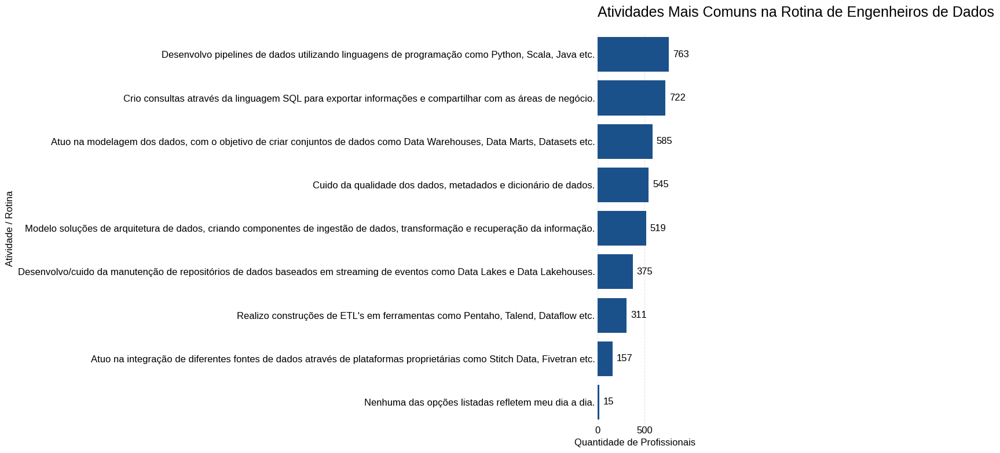

In [51]:
# Filtramos o dataframe para incluir apenas os Engenheiros de Dados.
df_engenheiros = df[df['cargo_principal'] == 'Engenharia de Dados'].copy()
print(f"Analisando a rotina de {len(df_engenheiros)} Engenheiros de Dados.")

# Identificamos as colunas relacionadas à rotina de DE (padrão '6.a.')
colunas_rotina_de = [col for col in df.columns if col.startswith('6.a.')]

# Somamos as respostas para obter a contagem de cada atividade.
contagem_rotina_de = df_engenheiros[colunas_rotina_de].sum().sort_values(ascending=False)

# Limpamos os nomes das colunas para usar como rótulos no gráfico.
contagem_rotina_de.index = contagem_rotina_de.index.str.replace(r'6\.a\.\d{1,2}_', '', regex=True)

# Geração do gráfico
ax = sns.barplot(
    x=contagem_rotina_de.values,
    y=contagem_rotina_de.index,
    color=COR_PRINCIPAL
)

# Títulos e rótulos
ax.set_title('Atividades Mais Comuns na Rotina de Engenheiros de Dados', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Quantidade de Profissionais', fontsize=12)
ax.set_ylabel('Atividade / Rotina', fontsize=12)

ax.bar_label(ax.containers[0], size=12, padding=5)

sns.despine(left=True, bottom=True)

plt.tight_layout()
plt.show()

### A rotina do Analista de Dados

Agora, vamos focar nos Analistas de Dados. Utilizando as respostas da Parte 7 do questionário, vamos descobrir quais são as tarefas mais comuns em sua rotina, como a criação de dashboards, a análise de dados com linguagens de programação e a modelagem de dados para conjuntos de dados.

Analisando a rotina de 1668 Analistas de Dados / BI.


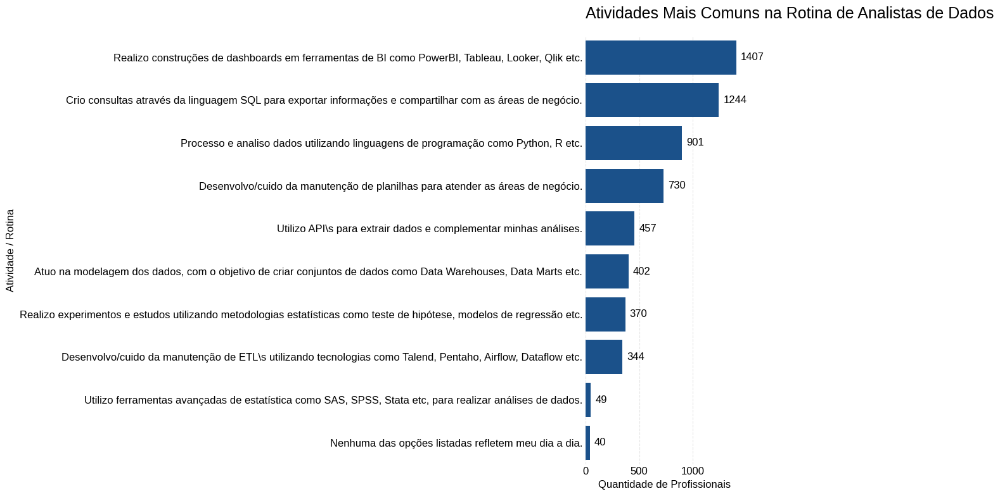

In [52]:
# Filtramos o dataframe para incluir apenas os Analistas de Dados / BI.
df_analistas = df[df['cargo_principal'] == 'Análise de Dados / BI'].copy()
print(f"Analisando a rotina de {len(df_analistas)} Analistas de Dados / BI.")

# Identificamos as colunas relacionadas à rotina de DA (padrão '7.a.')
colunas_rotina_da = [col for col in df.columns if col.startswith('7.a.')]

# Somamos as respostas para obter a contagem de cada atividade.
contagem_rotina_da = df_analistas[colunas_rotina_da].sum().sort_values(ascending=False)

# Limpamos os nomes das colunas para usar como rótulos no gráfico.
contagem_rotina_da.index = contagem_rotina_da.index.str.replace(r'7\.a\.\d{1,2}_', '', regex=True)

# Geração do gráfico
ax = sns.barplot(
    x=contagem_rotina_da.values,
    y=contagem_rotina_da.index,
    color=COR_PRINCIPAL
)

# Títulos e rótulos
ax.set_title('Atividades Mais Comuns na Rotina de Analistas de Dados', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Quantidade de Profissionais', fontsize=12)
ax.set_ylabel('Atividade / Rotina', fontsize=12)

ax.bar_label(ax.containers[0], size=12, padding=5)

sns.despine(left=True, bottom=True)

plt.tight_layout()
plt.show()

### A rotina do Cientista de Dados

Finalizando nosso aprofundamento nas especialidades, vamos agora investigar a rotina dos Cientistas de Dados. Com base nas respostas da Parte 8 do questionário, visualizaremos quais atividades, como a criação de modelos de Machine Learning, estudos Ad-hoc e limpeza de dados, são as mais frequentes no dia a dia deste perfil.

Analisando a rotina de 773 Cientistas de Dados / ML.


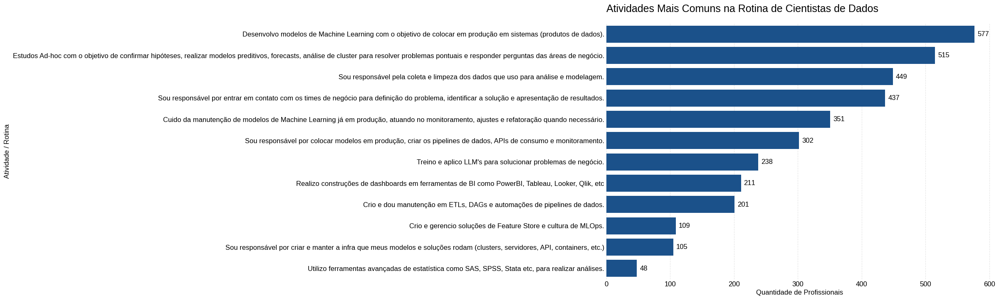

In [53]:
# Filtramos o dataframe para incluir apenas os Cientistas de Dados / ML.
df_cientistas = df[df['cargo_principal'] == 'Ciência de Dados / ML'].copy()
print(f"Analisando a rotina de {len(df_cientistas)} Cientistas de Dados / ML.")

# Identificamos as colunas relacionadas à rotina de DS (padrão '8.a.')
colunas_rotina_ds = [col for col in df.columns if col.startswith('8.a.')]

# Somamos as respostas para obter a contagem de cada atividade.
contagem_rotina_ds = df_cientistas[colunas_rotina_ds].sum().sort_values(ascending=False)

# Limpamos os nomes das colunas para usar como rótulos no gráfico.
contagem_rotina_ds.index = contagem_rotina_ds.index.str.replace(r'8\.a\.\d{1,2}_', '', regex=True)

# Geração do Gráfico de Barras Horizontais
ax = sns.barplot(
    x=contagem_rotina_ds.values,
    y=contagem_rotina_ds.index,
    color=COR_PRINCIPAL
)

# Títulos e rótulos
ax.set_title('Atividades Mais Comuns na Rotina de Cientistas de Dados', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Quantidade de Profissionais', fontsize=12)
ax.set_ylabel('Atividade / Rotina', fontsize=12)

ax.bar_label(ax.containers[0], size=12, padding=5)

sns.despine(left=True, bottom=True)

plt.tight_layout()
plt.show()

## **Análise de Diversidade e Inclusão**

Nesta seção, vamos nos aprofundar em um dos temas mais críticos levantados pelo relatório State of Data: a diversidade e inclusão no mercado de dados. O objetivo é analisar como diferentes grupos (gênero, cor/raça, PcD) percebem sua experiência profissional e investigar as disparidades apontadas na pesquisa.

### Experiência Profissional Afetada por Gênero

Iniciamos a análise investigando a percepção de impacto na carreira por gênero. O relatório aponta que 64,6% das mulheres sentem que sua experiência é afetada, um número drasticamente maior que o dos homens. Vamos visualizar essa disparidade.

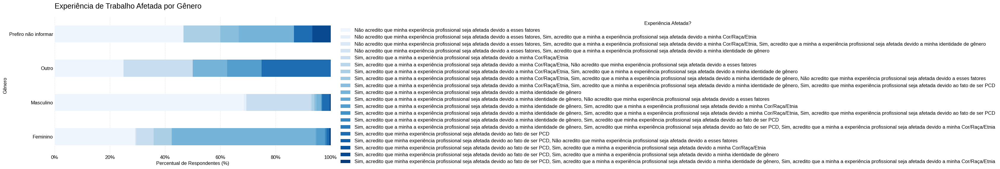

In [54]:
tabela_genero = pd.crosstab(
    df['1.b_genero'], 
    df['1.e_experiencia_profissional_prejudicada'], 
    normalize='index'
) * 100

# Geração do gráfico
ax = tabela_genero.plot(
    kind='barh', 
    stacked=True, 
    figsize=(12, 6),
    color=sns.color_palette(PALETA_PRINCIPAL, n_colors=len(tabela_genero.columns))
)

# Títulos e rótulos
ax.set_title('Experiência de Trabalho Afetada por Gênero', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Percentual de Respondentes (%)', fontsize=12)
ax.set_ylabel('Gênero', fontsize=12)

# Legenda
plt.legend(title='Experiência Afetada?', bbox_to_anchor=(1.02, 1), loc='upper left')

ax.xaxis.set_major_formatter(plt.FuncFormatter('{:.0f}%'.format))
plt.xlim(0, 100)

sns.despine(left=True, bottom=True)

plt.tight_layout()
plt.show()

### Experiência Profissional Afetada por Cor/Raça/Etnia

Seguindo a mesma linha de investigação, vamos agora analisar a percepção de impacto na carreira por cor/raça/etnia. O relatório oficial aponta que profissionais pretos (60,9%) e pardos (24%) são os que mais relatam ter suas experiências de trabalho afetadas.

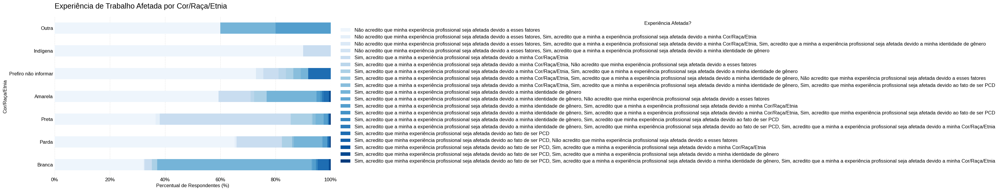

In [55]:
# Criamos a tabela de proporções
tabela_etnia = pd.crosstab(
    df['1.c_cor/raca/etnia'], 
    df['1.e_experiencia_profissional_prejudicada'], 
    normalize='index'
) * 100

# Ordenamos as categorias pela frequência de respondentes para melhor visualização
ordem_etnia = df['1.c_cor/raca/etnia'].value_counts().index
tabela_etnia = tabela_etnia.reindex(ordem_etnia)

# Geração do gráfico
ax = tabela_etnia.plot(
    kind='barh', 
    stacked=True, 
    figsize=(12, 7),
    color=sns.color_palette(PALETA_PRINCIPAL, n_colors=len(tabela_etnia.columns))
)

# Títulos e rótulos
ax.set_title('Experiência de Trabalho Afetada por Cor/Raça/Etnia', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Percentual de Respondentes (%)', fontsize=12)
ax.set_ylabel('Cor/Raça/Etnia', fontsize=12)

# legenda
plt.legend(title='Experiência Afetada?', bbox_to_anchor=(1.02, 1), loc='upper left')

ax.xaxis.set_major_formatter(plt.FuncFormatter('{:.0f}%'.format))
plt.xlim(0, 100)

sns.despine(left=True, bottom=True)

plt.tight_layout()
plt.show()

### Experiência Profissional Afetada por Deficiência (PcD)

Finalizando nossa análise sobre diversidade, investigamos a percepção de impacto na carreira para Pessoas com Deficiência. O relatório oficial aponta que um número significativo de 40,9% dos profissionais com deficiência sentem que sua experiência de trabalho é afetada. Vamos visualizar essa proporção.

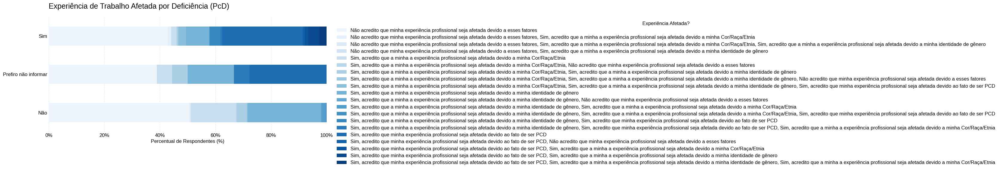

In [56]:
# Criamos a tabela de proporções usando o crosstab.
tabela_pcd = pd.crosstab(
    df['1.d_pcd'], 
    df['1.e_experiencia_profissional_prejudicada'], 
    normalize='index'
) * 100

# Geração do gráfico
ax = tabela_pcd.plot(
    kind='barh', 
    stacked=True, 
    figsize=(12, 5), # Ajustei a altura para um gráfico com poucas barras
    color=sns.color_palette(PALETA_PRINCIPAL, n_colors=len(tabela_pcd.columns))
)

# Títulos e rótulos
ax.set_title('Experiência de Trabalho Afetada por Deficiência (PcD)', fontsize=18, loc='left', pad=20)
ax.set_xlabel('Percentual de Respondentes (%)', fontsize=12)
ax.set_ylabel('')

# Legenda
plt.legend(title='Experiência Afetada?', bbox_to_anchor=(1.02, 1), loc='upper left')

ax.xaxis.set_major_formatter(plt.FuncFormatter('{:.0f}%'.format))
plt.xlim(0, 100)

sns.despine(left=True, bottom=True)

plt.tight_layout()
plt.show()

## **Conclusão do Projeto: Um Retrato do Ecossistema de Dados no Brasil**

Este projeto realizou uma análise profunda e multifacetada do "State of Data Brazil 2024-2025", transformando dados brutos de uma pesquisa em um panorama claro sobre o profissional de dados no país. Através de um cuidadoso processo de limpeza, engenharia de features e visualização de dados, foi possível extrair *insights* valiosos sobre demografia, carreira, remuneração, tecnologias e diversidade.

### Principais Descobertas:

* **Perfil do Profissional:** A análise demográfica confirmou a forte concentração de profissionais na região Sudeste, com São Paulo como o principal polo. Revelou-se também um mercado predominantemente jovem, com a maioria dos talentos na faixa dos 25 a 34 anos, e uma notável disparidade de gênero, com presença majoritariamente masculina.

* **Carreira e Remuneração:** A progressão de carreira está diretamente atrelada a um aumento salarial significativo. A análise demonstrou que, embora todas as áreas (Análise, Engenharia e Ciência de Dados) apresentem crescimento, a Engenharia de Dados se destaca com as maiores medianas salariais nos níveis pleno e sênior. Além disso, a principal motivação para a busca de um novo emprego é a busca por melhores salários, seguida pela falta de oportunidades de crescimento.

* **Tecnologias Dominantes:** O ecossistema tecnológico é claramente dominado por Python e SQL como as linguagens de programação essenciais. No que tange a ferramentas, Power BI reina como a plataforma de BI mais utilizada, enquanto AWS, Azure e GCP formam o tripé fundamental das competências em nuvem.

* **Desafios da Liderança:** Para os gestores, os maiores desafios não são técnicos, mas sim organizacionais: a falta de cultura de dados nas empresas e a dificuldade em mensurar o ROI (Retorno sobre o Investimento) das iniciativas de dados são as principais barreiras enfrentadas.

* **Diversidade e Inclusão:** A análise confirmou um ponto crítico levantado pela pesquisa original: uma parcela significativa de profissionais pertencentes a grupos minorizados (mulheres, pessoas pretas e pardas, e pessoas com deficiência) sente que sua experiência profissional é negativamente afetada por sua condição, evidenciando um desafio estrutural a ser superado pelo mercado.

Em suma, este trabalho não apenas validou visualmente as principais conclusões do relatório oficial, mas também gerou cruzamentos e *insights* originais que pintam um retrato detalhado do profissional de dados brasileiro: um indivíduo qualificado, concentrado nos grandes centros urbanos, que busca valorização financeira e crescimento, e que navega em um ecossistema tecnológico bem definido, embora ainda enfrente barreiras culturais e de diversidade em seu ambiente de trabalho.